<a href="https://www.kaggle.com/code/vibhumishra14/india-suicide-rates-eda-2001-2012?scriptVersionId=127776128" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

<h1 style="text-align:center; font-size:45px">India Suicide Rates EDA (2001-2012)</h1>

# About the Dataset:

<h3>Context</h3>

This data set contains yearly suicide detail of all the states/u.t of India by various parameters from 2001 to 2012.

<h3>Content</h3>

Time Period: 2001 - 2012 <br>
Granularity: Yearly <br>
Location: States and U.T's of India

<h3>Parameters</h3>

    a) Suicide causes
    b) Education status
    c) By means adopted
    d) Professional profile
    e) Social status

<h3>Acknowledgements</h3>

National Crime Records Bureau (NCRB), Govt of India has shared this dataset under Govt. Open Data License - India. <br>
Source Link: (https://data.gov.in/)

# Table of Contents:

1. <a href='#Importing-necessary-libraries:'><h3>Importing Libraries</h3></a>
2. <a href='#Reading-the-dataset:'><h3>Reading the dataset</h3></a>
3. <a href='#Data-Pre-processing:'><h3>Data Pre-processing</h3></a>
3. <a href='#Exploratory-Data-Analysis:'><h3>Exploratory Data Analysis (EDA)</h3></a>

# Importing necessary libraries:

In [1]:
# Data Manipulation/Representation Libraries
import numpy as np
import pandas as pd

In [2]:
# Data Visualization Libraries
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [3]:
# Setting DPI for Figure Level Plots
plt.rcParams["figure.dpi"] = 720

# Reading the dataset:

In [4]:
# Importing DataSet
df = pd.read_csv('/kaggle/input/suicides-in-india/Suicides in India 2001-2012.csv')
df

,State,Year,Type_code,Type,Gender,Age_group,Total
0,A & N Islands,2001,Causes,Illness (Aids/STD),Female,0-14,0
1,A & N Islands,2001,Causes,Bankruptcy or Sudden change in Economic,Female,0-14,0
2,A & N Islands,2001,Causes,Cancellation/Non-Settlement of Marriage,Female,0-14,0
3,A & N Islands,2001,Causes,Physical Abuse (Rape/Incest Etc.),Female,0-14,0
4,A & N Islands,2001,Causes,Dowry Dispute,Female,0-14,0
...,...,...,...,...,...,...,...
237514,West Bengal,2012,Social_Status,Seperated,Male,0-100+,149
237515,West Bengal,2012,Social_Status,Widowed/Widower,Male,0-100+,233
237516,West Bengal,2012,Social_Status,Married,Male,0-100+,5451
237517,West Bengal,2012,Social_Status,Divorcee,Male,0-100+,189


In [5]:
print('Number of Rows: ' + str(df.shape[0]) + '\nNumber of Columns: ' + str(df.shape[1]))

Number of Rows: 237519
Number of Columns: 7


In [6]:
# Dataset Information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 237519 entries, 0 to 237518
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype 
---  ------     --------------   ----- 
 0   State      237519 non-null  object
 1   Year       237519 non-null  int64 
 2   Type_code  237519 non-null  object
 3   Type       237519 non-null  object
 4   Gender     237519 non-null  object
 5   Age_group  237519 non-null  object
 6   Total      237519 non-null  int64 
dtypes: int64(2), object(5)
memory usage: 12.7+ MB


In [7]:
# Basic Analytics for Total Suicides
df['Total'].describe()

count    237519.000000
mean         55.034477
std         792.749038
min           0.000000
25%           0.000000
50%           0.000000
75%           6.000000
max       63343.000000
Name: Total, dtype: float64

### Checking for Distinct Values in each column:

In [8]:
df[['Year', 'Total']].groupby('Year', as_index=False).count()

,Year,Total
0,2001,19797
1,2002,19790
2,2003,19786
3,2004,19783
4,2005,19803
5,2006,19786
6,2007,19794
7,2008,19797
8,2009,19786
9,2010,19792


In [9]:
df['Age_group'].value_counts()

15-29     45223
30-44     45193
45-59     45146
60+       45074
0-14      45027
0-100+    11856
Name: Age_group, dtype: int64

In [10]:
df['State'].value_counts()

Madhya Pradesh       6792
Maharashtra          6792
Karnataka            6792
Odisha               6791
Andhra Pradesh       6791
Rajasthan            6791
Bihar                6790
Chhattisgarh         6790
Haryana              6790
Kerala               6788
Uttar Pradesh        6787
Assam                6786
Tamil Nadu           6786
Gujarat              6786
Jharkhand            6785
Tripura              6782
Delhi (Ut)           6782
West Bengal          6780
Punjab               6779
Himachal Pradesh     6774
Jammu & Kashmir      6761
Goa                  6759
Uttarakhand          6758
Sikkim               6742
Mizoram              6737
Meghalaya            6733
Puducherry           6730
Chandigarh           6717
A & N Islands        6712
Daman & Diu          6710
Arunachal Pradesh    6707
Nagaland             6705
D & N Haveli         6704
Manipur              6700
Lakshadweep          6674
Total (All India)     312
Total (States)        312
Total (Uts)           312
Name: State,

In [11]:
df['Type_code'].value_counts()

Causes                  109200
Means_adopted            67200
Professional_Profile     49263
Education_Status          7296
Social_Status             4560
Name: Type_code, dtype: int64

### All the Distinct Methods adopted for Suicide in our Dataset:

In [12]:
df[df['Type_code'] == 'Means_adopted']['Type'].value_counts()

By Consuming Insecticides                  4200
By Over Alcoholism                         4200
By Fire-Arms                               4200
By Drowning                                4200
By Jumping from (Building)                 4200
By Overdose of sleeping pills              4200
By coming under running vehicles/trains    4200
By Consuming Other Poison                  4200
By Self Infliction of injury               4200
By Hanging                                 4200
By Jumping off Moving Vehicles/Trains      4200
By Fire/Self Immolation                    4200
By Machine                                 4200
By touching electric wires                 4200
By Jumping from (Other sites)              4200
By Other means (please specify)            3850
By Other means                              350
Name: Type, dtype: int64

### Professions in our Dataset:

In [13]:
df[df['Type_code'] == 'Professional_Profile']['Type'].value_counts()

Others (Please Specify)              7263
Retired Person                       4200
Unemployed                           4200
Public Sector Undertaking            4200
Service (Private)                    4200
House Wife                           4200
Self-employed (Business activity)    4200
Professional Activity                4200
Student                              4200
Farming/Agriculture Activity         4200
Service (Government)                 4200
Name: Type, dtype: int64

### Education Statuses in our Dataset:

In [14]:
df[df['Type_code'] == 'Education_Status']['Type'].value_counts()

Diploma                                     912
No Education                                912
Post Graduate and Above                     912
Middle                                      912
Graduate                                    912
Hr. Secondary/Intermediate/Pre-Universit    912
Primary                                     912
Matriculate/Secondary                       912
Name: Type, dtype: int64

### Relationship Statuses in our Dataset:

In [15]:
df[df['Type_code'] == 'Social_Status']['Type'].value_counts()

Married            912
Seperated          912
Widowed/Widower    912
Divorcee           912
Never Married      912
Name: Type, dtype: int64

---

### Checking For Null Values:

In [16]:
# Checking for NULL values
df.isnull().sum()

State        0
Year         0
Type_code    0
Type         0
Gender       0
Age_group    0
Total        0
dtype: int64

- **There is no null values in the dataSet**

# Data Pre-processing:

In [17]:
df['State'].value_counts()

Madhya Pradesh       6792
Maharashtra          6792
Karnataka            6792
Odisha               6791
Andhra Pradesh       6791
Rajasthan            6791
Bihar                6790
Chhattisgarh         6790
Haryana              6790
Kerala               6788
Uttar Pradesh        6787
Assam                6786
Tamil Nadu           6786
Gujarat              6786
Jharkhand            6785
Tripura              6782
Delhi (Ut)           6782
West Bengal          6780
Punjab               6779
Himachal Pradesh     6774
Jammu & Kashmir      6761
Goa                  6759
Uttarakhand          6758
Sikkim               6742
Mizoram              6737
Meghalaya            6733
Puducherry           6730
Chandigarh           6717
A & N Islands        6712
Daman & Diu          6710
Arunachal Pradesh    6707
Nagaland             6705
D & N Haveli         6704
Manipur              6700
Lakshadweep          6674
Total (All India)     312
Total (States)        312
Total (Uts)           312
Name: State,

- **We are able to see that there are certain values such as Total (All India), Total(States), Total(Uts)**
- **These values can be removed from the dataset before further analysis.**

In [18]:
# Removing redundant values from 'States' Column:
df = df[(df['State'] != 'Total (All India)') 
        & (df['State'] != 'Total (States)') 
        & (df['State'] != 'Total (Uts)')]

In [19]:
df['State'].value_counts()

Karnataka            6792
Madhya Pradesh       6792
Maharashtra          6792
Andhra Pradesh       6791
Odisha               6791
Rajasthan            6791
Chhattisgarh         6790
Bihar                6790
Haryana              6790
Kerala               6788
Uttar Pradesh        6787
Tamil Nadu           6786
Gujarat              6786
Assam                6786
Jharkhand            6785
Tripura              6782
Delhi (Ut)           6782
West Bengal          6780
Punjab               6779
Himachal Pradesh     6774
Jammu & Kashmir      6761
Goa                  6759
Uttarakhand          6758
Sikkim               6742
Mizoram              6737
Meghalaya            6733
Puducherry           6730
Chandigarh           6717
A & N Islands        6712
Daman & Diu          6710
Arunachal Pradesh    6707
Nagaland             6705
D & N Haveli         6704
Manipur              6700
Lakshadweep          6674
Name: State, dtype: int64

# Exploratory Data Analysis:

In [20]:
df_causes = df[df['Type_code'] == 'Causes']

### Total number of people who has committed suicide from 2001 - 2012:

Suicides 2001 - 12:
        Total
Year        
2001  108506
2002  110417
2003  110851
2004  113697
2005  113914
2006  118112
2007  122637
2008  125017
2009  127151
2010  134599
2011  135585
2012  120488


<AxesSubplot:title={'center':'Number of Suicides each Year From 2001 - 12'}, xlabel='Year', ylabel='Total Suicides'>

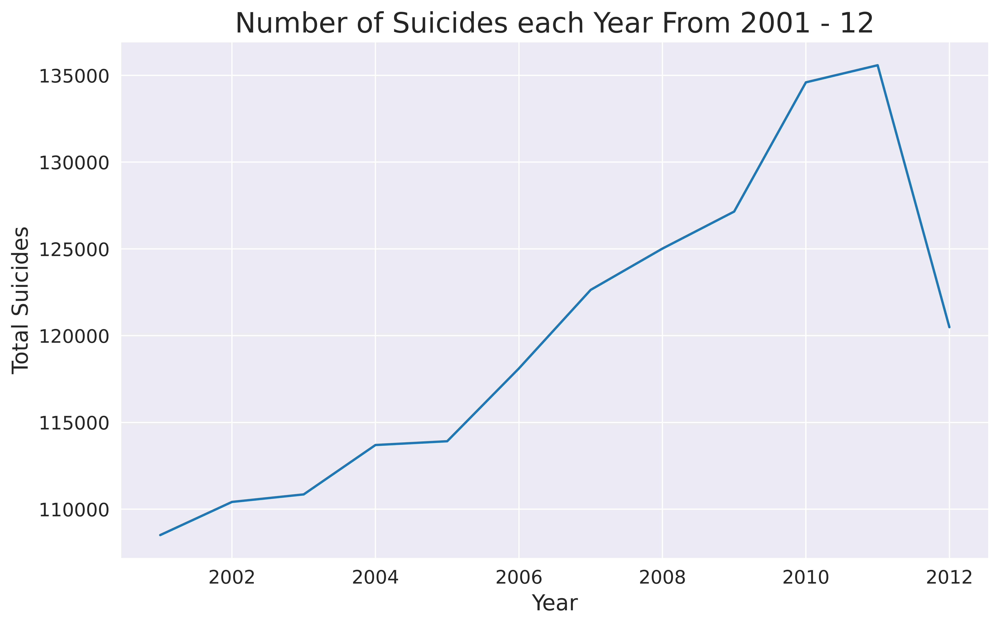

In [21]:
print('Suicides 2001 - 12:\n',df_causes.groupby('Year').sum())
tot_suicide = df_causes.groupby('Year').sum()
sns.set_style(style='darkgrid')
plt.figure(figsize=(10,6), dpi=720)
plt.title("Number of Suicides each Year From 2001 - 12", fontsize=18)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.ylabel('Total Suicides', fontsize=14)
plt.xlabel('Year', fontsize=14)
sns.lineplot(x='Year', y='Total', data=tot_suicide)

### Suicide Across States:

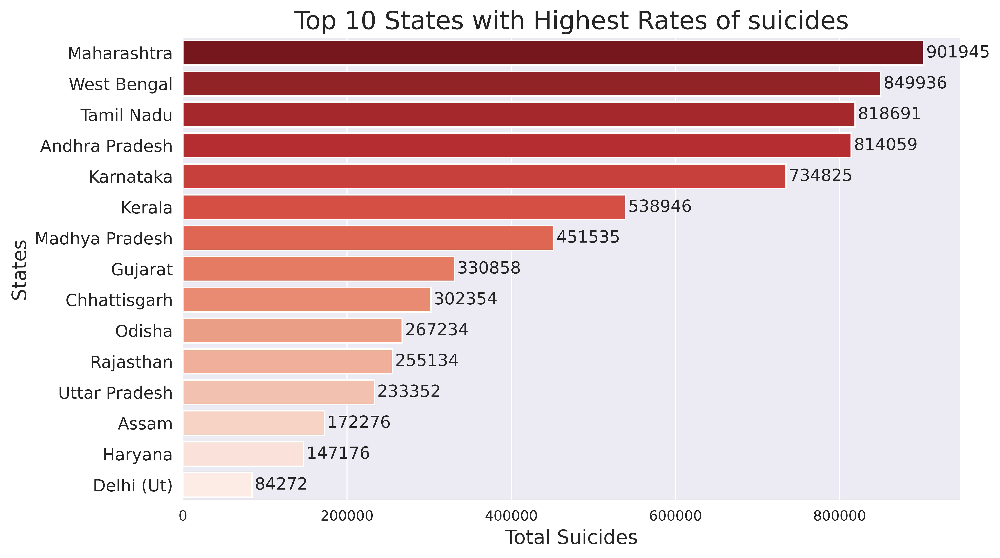

In [22]:
filter_state = df.groupby('State', as_index=False).sum()[['State','Total']].sort_values(by='Total', ascending=False).head(15)
plt.figure(figsize=(10,6), dpi=720)
c1 = sns.barplot(x='Total', y='State', data=filter_state, palette='Reds_r')
c1.bar_label(c1.containers[0], padding=2, size=12)
plt.title("Top 10 States with Highest Rates of suicides", fontsize=18)
plt.ylabel("States", fontsize=14)
plt.yticks(fontsize=12)
plt.xlabel("Total Suicides", fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- Maharashtra , West Bengal , Tamil Nadu and Andhra Pradesh seems to have highest rates of suicides from 2000-2012.

### Gender which tends to commit more Suicides:

   Gender    Total
0  Female  2606922
1    Male  4641088


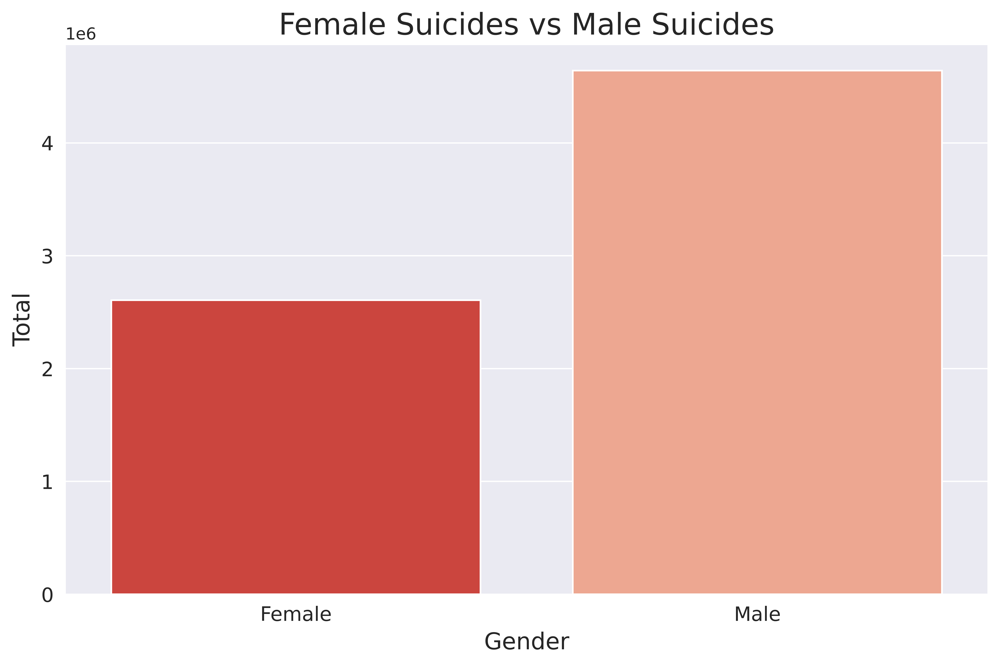

In [23]:
filter_gender = df.groupby('Gender', as_index=False).sum()[['Gender', 'Total']]
print(filter_gender)
plt.figure(figsize=(10,6), dpi=720)
c1 = sns.barplot(x='Gender', y='Total', data=filter_gender, palette='Reds_r')
plt.title("Female Suicides vs Male Suicides", fontsize=18)
plt.ylabel("Total", fontsize=14)
plt.yticks(fontsize=12)
plt.xlabel("Gender", fontsize=14)
plt.xticks(fontsize=12)
plt.show()

**Inference**
- Males tends to commit more suicides than Females in India.

### Rate of Change of the number of suicide cases over the years:

    Year  Gender   Total
0   2001  Female  210877
1   2001    Male  331563
2   2002  Female  205335
3   2002    Male  346645
4   2003  Female  203137
5   2003    Male  351081
6   2004  Female  205113
7   2004    Male  363236
8   2005  Female  204988
9   2005    Male  364557
10  2006  Female  212037
11  2006    Male  378506
12  2007  Female  216664
13  2007    Male  396455
14  2008  Female  222310
15  2008    Male  402704
16  2009  Female  228330
17  2009    Male  407099
18  2010  Female  237029
19  2010    Male  435897
20  2011  Female  238704
21  2011    Male  438455
22  2012  Female  222398
23  2012    Male  424890


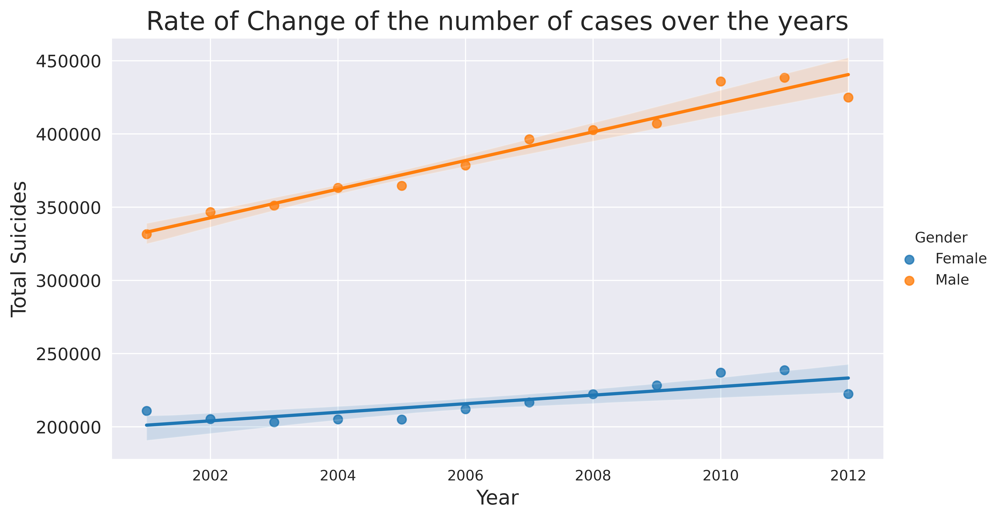

In [24]:
grp_year = df.groupby(['Year', 'Gender'], as_index=False)['Total'].sum()
print(grp_year)
sns.lmplot(x='Year', y='Total', hue='Gender', data=grp_year, height=4.8, aspect=1.8)
plt.title("Rate of Change of the number of cases over the years", fontsize=18)
plt.ylabel("Total Suicides", fontsize=14)
plt.yticks(fontsize=12)
plt.xlabel("Year", fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- There is higher positive slop for males when compared to females
- Indicating that more men would likely resort to suicide in future.

### Comparison of the suicide of the Genders over the years:

In [25]:
year = df_causes.groupby('Year')['Total'].sum().to_frame()

women = df_causes[df_causes['Gender'] == 'Female']
women_year = women.groupby('Year')['Total'].sum().to_frame()
women_year.rename(columns = {'Total':'Female'}, inplace=True)

men = df_causes[df_causes['Gender'] == 'Male']
men_year = men.groupby('Year')['Total'].sum().to_frame()
men_year.rename(columns = {'Total' : 'Male'}, inplace=True)

gender_year = men_year.join(women_year)
gender_year.reset_index(inplace=True)

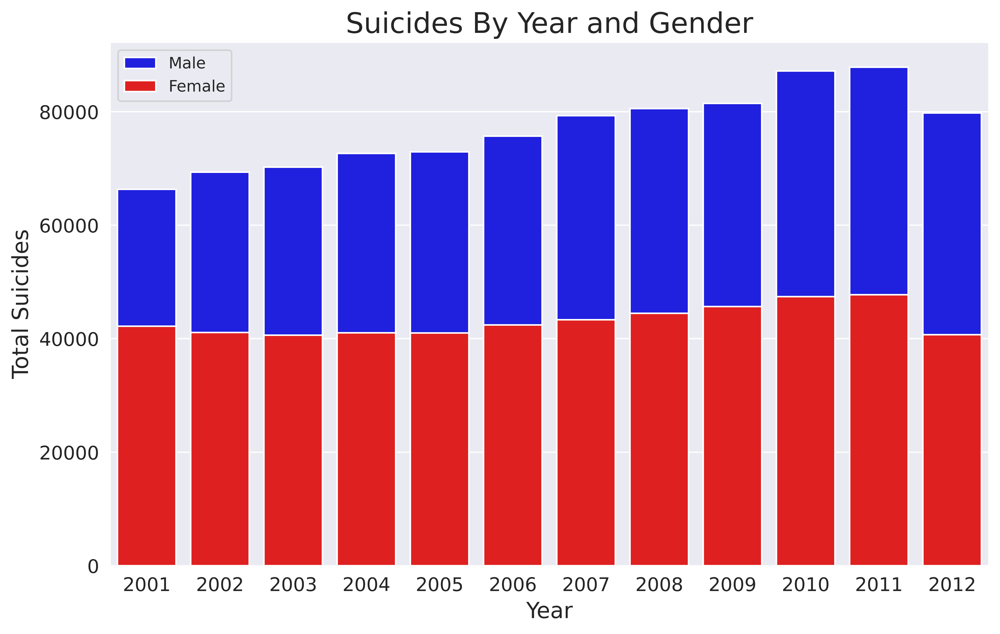

In [26]:
plt.figure(figsize=(10,6), dpi=720)
sns.barplot(x='Year', y='Male', data=gender_year, color='blue', label='Male')
sns.barplot(x='Year', y='Female', data=gender_year, color='red', label='Female')
plt.title("Suicides By Year and Gender", fontsize=18)
plt.xlabel("Year", fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel("Total Suicides", fontsize=14)
plt.yticks(fontsize=12)
plt.legend()
plt.show()

### Gender-wise suicide in States:

In [27]:
state_gender = (df_causes.groupby(["State","Gender",'Year'])
        .agg(value=pd.NamedAgg(column="Total",aggfunc="sum"))['value']
        .unstack(fill_value=0)
        .rename_axis(None, axis=1)
        .unstack())
state_gender['Total']=state_gender.sum(axis=1, numeric_only=True)
state_gender.style.background_gradient(cmap='Reds')

---

## Cause of Suicides:

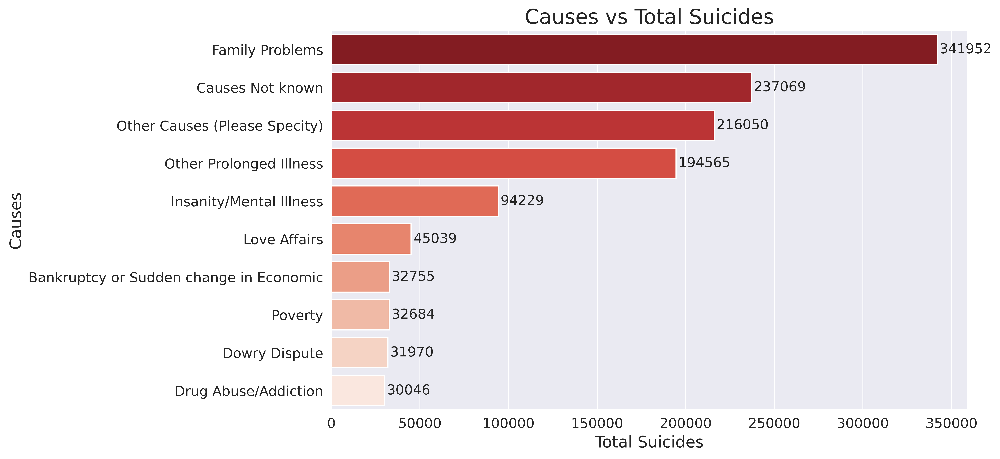

In [28]:
plt.figure(figsize=(10,6), dpi=720)
temp = df_causes[['Type', 'Total']].groupby('Type', as_index=False).sum().sort_values('Total', ascending=False).head(10)
c1 = sns.barplot(y=temp['Type'], x=temp['Total'], palette='Reds_r')
c1.bar_label(c1.containers[0], padding=2, size=12)
plt.title('Causes vs Total Suicides', fontsize=18)
plt.ylabel('Causes', fontsize=14)
plt.yticks(fontsize=12)
plt.xlabel('Total Suicides', fontsize=14)
plt.xticks(fontsize=12)
plt.show()

**Inference**
- Family Problems seems to be the leading cause of suicides among people
- While Illness also contributed to high rates of suicides, most of the times the very cause of the suicide isn't known.

### Family Problems

In [29]:
df_causes_fp = df_causes[df_causes.Type == 'Family Problems']
df_causes_fp.head()

,State,Year,Type_code,Type,Gender,Age_group,Total
5,A & N Islands,2001,Causes,Family Problems,Female,0-14,0
29,A & N Islands,2001,Causes,Family Problems,Male,0-14,0
69,A & N Islands,2001,Causes,Family Problems,Female,15-29,5
88,A & N Islands,2001,Causes,Family Problems,Male,15-29,3
112,A & N Islands,2001,Causes,Family Problems,Female,30-44,0


**Gender wise Suicide on the basis of Family Problems:**

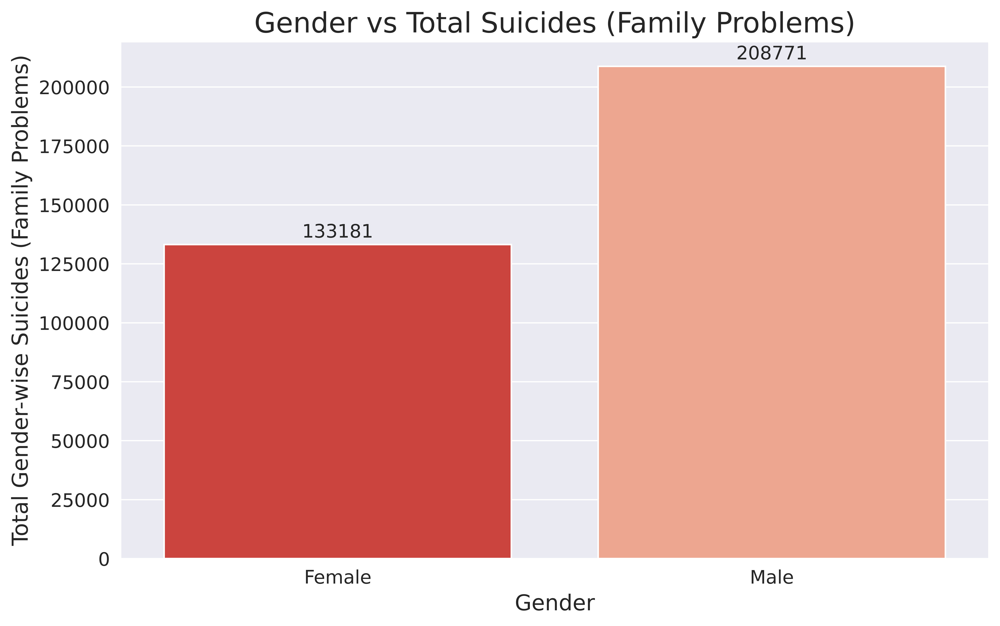

In [30]:
temp = df_causes_fp[['Gender', 'Total']].groupby(['Gender']).sum()
plt.figure(figsize=(10,6), dpi=720)
plt.title('Gender vs Total Suicides (Family Problems)', fontsize=18)
c1 = sns.barplot(x=temp.index, y=temp.Total, palette='Reds_r')
c1.bar_label(c1.containers[0], padding=2, size=12)
plt.xlabel('Gender', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Gender-wise Suicides (Family Problems)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- Again Males tend to take the decision to suicide more when compared to females.

**Age-group wise Suicide rates on the basis of Family Problems:**

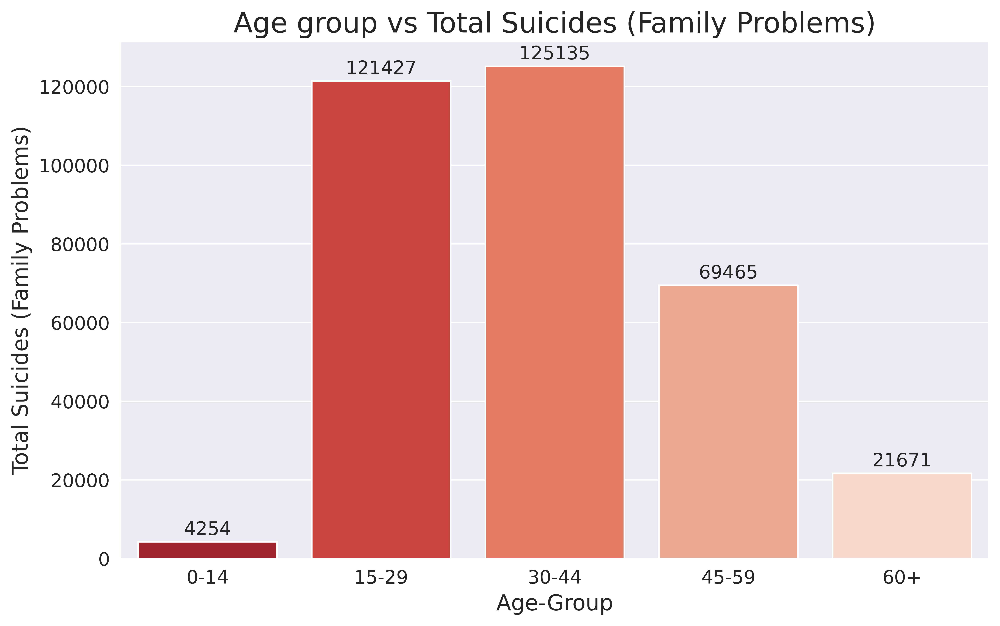

In [31]:
temp = df_causes_fp[['Age_group', 'Total']].groupby(['Age_group']).sum()
plt.figure(figsize=(10,6), dpi=720)
plt.title('Age group vs Total Suicides (Family Problems)', fontsize=18)
c1 = sns.barplot(x=temp.index, y=temp.Total, palette='Reds_r')
c1.bar_label(c1.containers[0],padding=2, size=12)
plt.xlabel('Age-Group', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Suicides (Family Problems)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- People in their mid 30's till mid 40's tend to suicide a lot more closely followed by people in the their youth (15-29).

**State wise Suicide rates on the basis of Family Problems:**

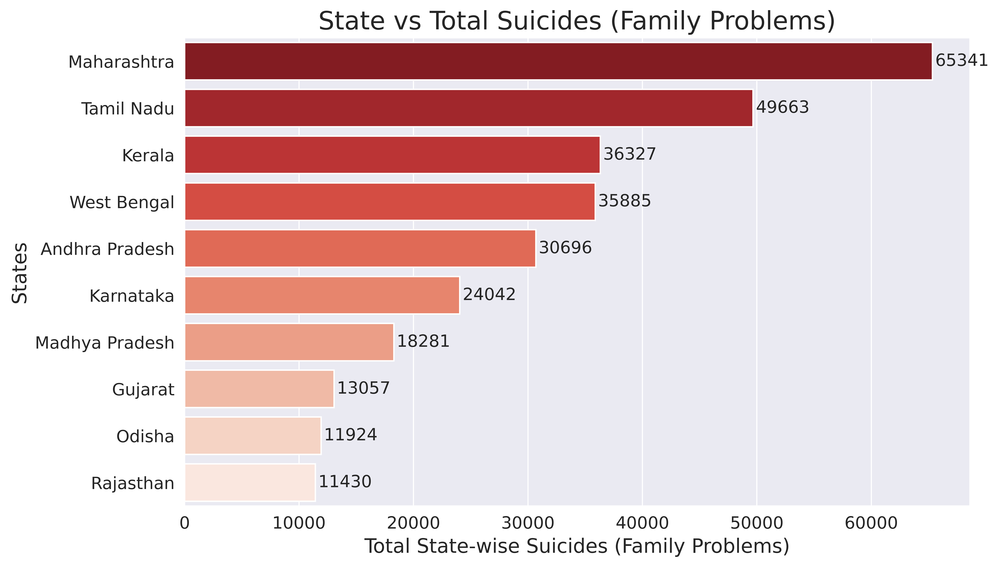

In [32]:
temp = df_causes_fp[['State', 'Total']].groupby(['State']).sum().sort_values('Total', ascending=False).head(10)
plt.figure(figsize=(10,6), dpi=720)
plt.title('State vs Total Suicides (Family Problems)', fontsize=18)
c1 = sns.barplot(y=temp.index, x=temp.Total, palette='Reds_r')
c1.bar_label(c1.containers[0], padding=2, size=12)
plt.ylabel('States', fontsize=14)
plt.yticks(fontsize=12)
plt.xlabel('Total State-wise Suicides (Family Problems)', fontsize=14)
plt.xticks(fontsize=12)
plt.show()

**Inference**
- Maharashtra as usual leads the suicide rates for people dealing with family problems
- followed by Tamil nadu and Kerla.

### Insanity/Mental Illness

In [33]:
df_causes_mi = df_causes[df_causes.Type == 'Insanity/Mental Illness']
df_causes_mi.head()

,State,Year,Type_code,Type,Gender,Age_group,Total
12,A & N Islands,2001,Causes,Insanity/Mental Illness,Female,0-14,0
49,A & N Islands,2001,Causes,Insanity/Mental Illness,Male,0-14,0
77,A & N Islands,2001,Causes,Insanity/Mental Illness,Female,15-29,2
90,A & N Islands,2001,Causes,Insanity/Mental Illness,Male,15-29,2
127,A & N Islands,2001,Causes,Insanity/Mental Illness,Female,30-44,2


**Gender wise Suicide on the basis of Mental Illness:**

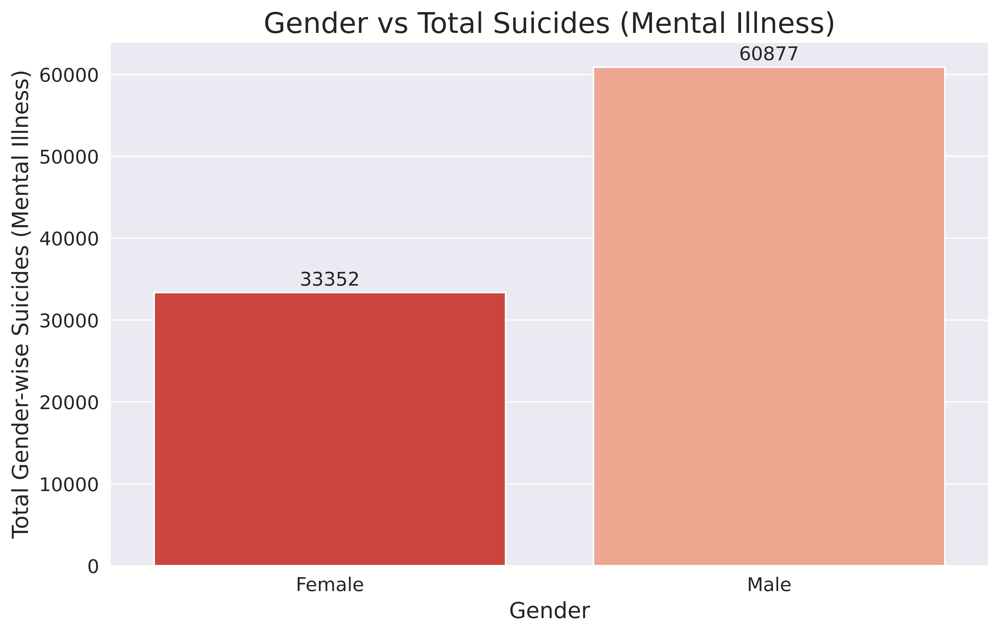

In [34]:
temp = df_causes_mi[['Gender','Total']].groupby(['Gender']).sum()
plt.figure(figsize=(10,6), dpi=720)
plt.title('Gender vs Total Suicides (Mental Illness)',fontsize=18)
c1 = sns.barplot(x=temp.index,y=temp.Total,palette="Reds_r")
c1.bar_label(c1.containers[0], padding=2, size = 12)
plt.xlabel('Gender', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Gender-wise Suicides (Mental Illness)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Age-group wise Suicide rates on the basis of Mental Illness:**

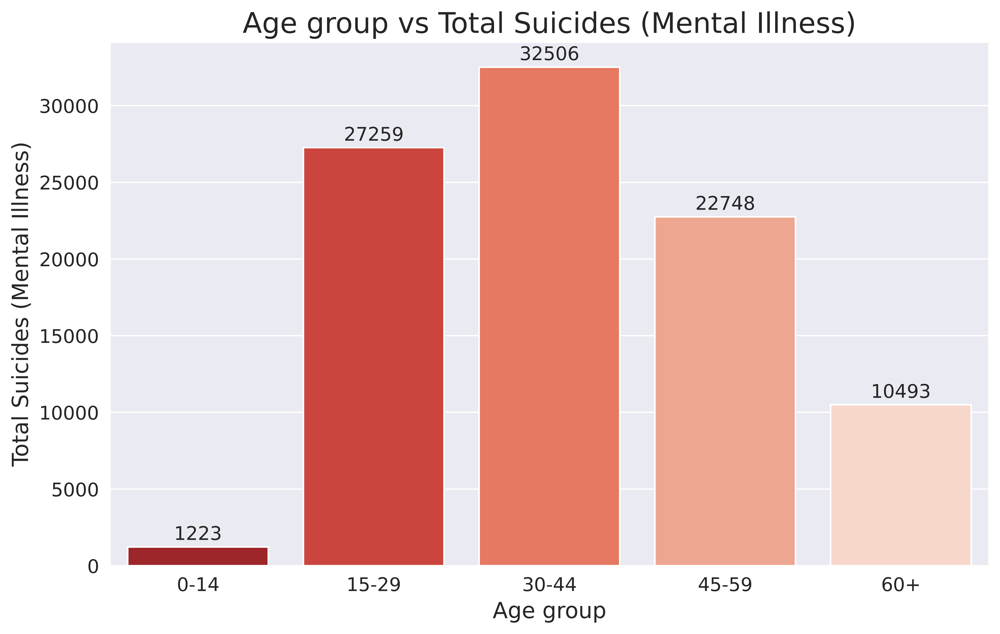

In [35]:
temp = df_causes_mi[['Age_group','Total']].groupby(['Age_group']).sum()
plt.figure(figsize=(10,6), dpi=720)
c1= sns.barplot(x=temp.index,y=temp.Total,palette="Reds_r")
c1.bar_label(c1.containers[0],padding=2, size=12)
plt.title('Age group vs Total Suicides (Mental Illness)',fontsize=18)
plt.xlabel('Age group', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Suicides (Mental Illness)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**State wise Suicide rates on the basis of Mental Illness:**

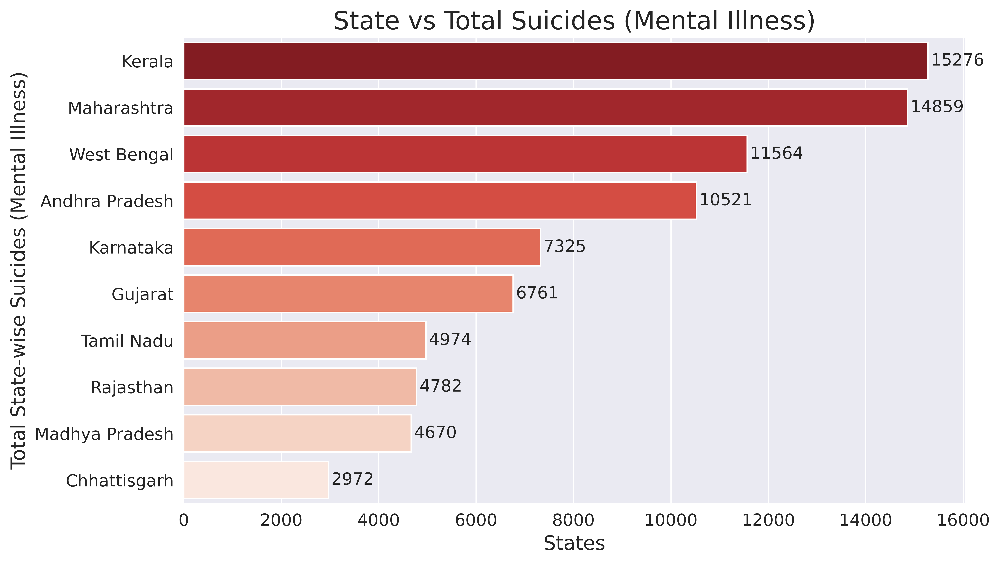

In [36]:
temp = df_causes_mi[['State','Total']].groupby(['State']).sum().sort_values('Total',ascending=False).head(10)
plt.figure(figsize=(10,6), dpi=720)
plt.title('State vs Total Suicides (Mental Illness)',fontsize=18)
c1 = sns.barplot(y=temp.index,x=temp.Total,palette="Reds_r")
c1.bar_label(c1.containers[0], padding=2, size = 12)
plt.xlabel('States', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total State-wise Suicides (Mental Illness)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- Kerla is closely followed by Maharashtra where many people get to suicide due to mental illness.
- West Bengal also has high rates of suicides due to mental illness.

### Love Affairs

In [37]:
df_causes_la = df_causes[df_causes.Type == 'Love Affairs']
df_causes_la.head()

,State,Year,Type_code,Type,Gender,Age_group,Total
13,A & N Islands,2001,Causes,Love Affairs,Female,0-14,1
42,A & N Islands,2001,Causes,Love Affairs,Male,0-14,0
65,A & N Islands,2001,Causes,Love Affairs,Female,15-29,0
89,A & N Islands,2001,Causes,Love Affairs,Male,15-29,3
128,A & N Islands,2001,Causes,Love Affairs,Female,30-44,0


**Gender wise Suicide on the basis of Love Affairs:**

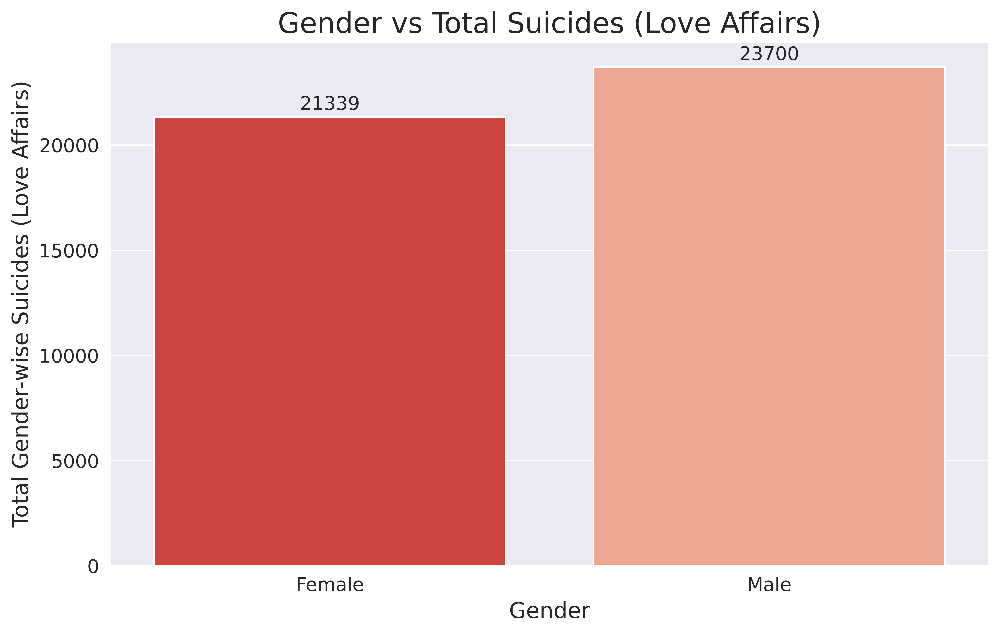

In [38]:
temp = df_causes_la[['Gender','Total']].groupby(['Gender']).sum()
plt.figure(figsize=(10,6), dpi=720)
plt.title('Gender vs Total Suicides (Love Affairs)',fontsize=18)
c1 = sns.barplot(x=temp.index,y=temp.Total,palette="Reds_r")
c1.bar_label(c1.containers[0],padding=2, size = 12)
plt.xlabel('Gender', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Gender-wise Suicides (Love Affairs)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- Slightly Males tend to more suicides when compared to females due to love affairs.

**Age-group wise Suicide rates on the basis of Love Affairs:**

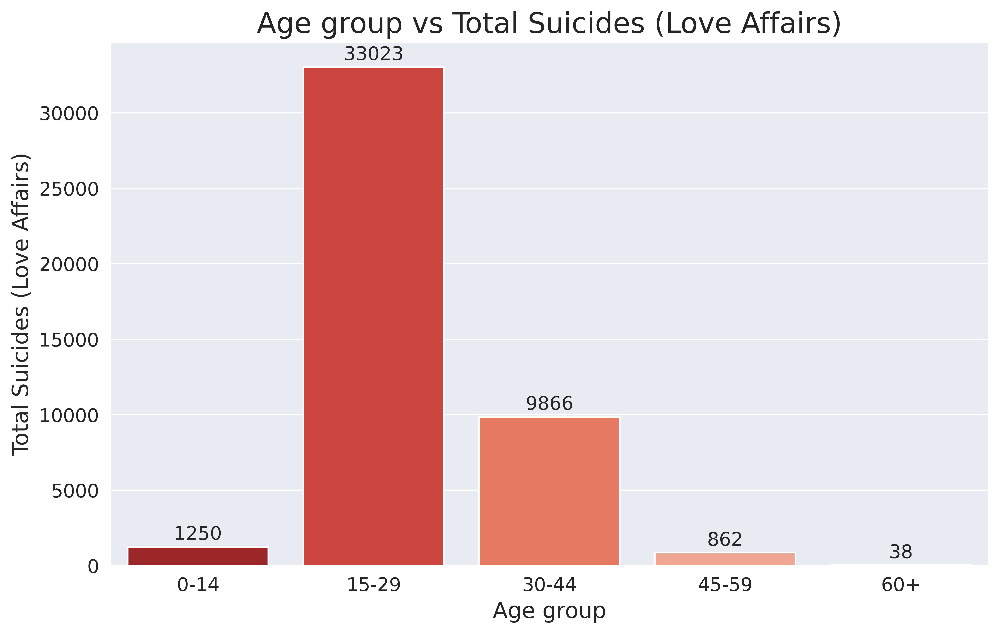

In [39]:
temp = df_causes_la[['Age_group','Total']].groupby(['Age_group']).sum()
plt.figure(figsize=(10,6), dpi=720)
c1= sns.barplot(x=temp.index,y=temp.Total,palette="Reds_r")
c1.bar_label(c1.containers[0],padding=2, size=12)
plt.title('Age group vs Total Suicides (Love Affairs)',fontsize=18)
plt.xlabel('Age group', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Suicides (Love Affairs)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- People in the age group of 15-29 tend to take rash decision of suiciding way more than the people belonging to other age groups.

**State wise Suicide rates on the basis of Love Affairs:**

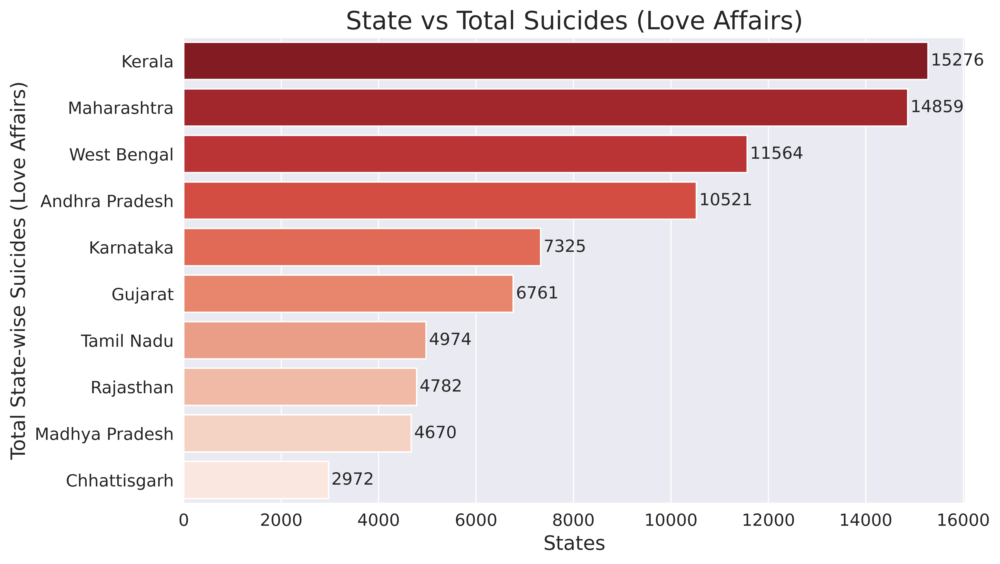

In [40]:
temp = df_causes_mi[['State','Total']].groupby(['State']).sum().sort_values('Total',ascending=False).head(10)
plt.figure(figsize=(10,6), dpi=720)
plt.title('State vs Total Suicides (Love Affairs)',fontsize=18)
c1 = sns.barplot(y=temp.index,x=temp.Total,palette="Reds_r")
c1.bar_label(c1.containers[0], padding=2, size = 12)
plt.xlabel('States', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total State-wise Suicides (Love Affairs)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- Maharashtra is the second most state for having suicides due to love affairs
- While we have seen already that Maharashtra had topped in suicides due to Family Problems.

### Bankruptcy or Sudden change in Economic

In [41]:
df_causes_bank = df_causes[df_causes.Type == 'Bankruptcy or Sudden change in Economic']
df_causes_bank.head()

,State,Year,Type_code,Type,Gender,Age_group,Total
1,A & N Islands,2001,Causes,Bankruptcy or Sudden change in Economic,Female,0-14,0
48,A & N Islands,2001,Causes,Bankruptcy or Sudden change in Economic,Male,0-14,0
56,A & N Islands,2001,Causes,Bankruptcy or Sudden change in Economic,Female,15-29,0
84,A & N Islands,2001,Causes,Bankruptcy or Sudden change in Economic,Male,15-29,0
118,A & N Islands,2001,Causes,Bankruptcy or Sudden change in Economic,Female,30-44,0


**Gender wise Suicide on the basis of Economic Factors:**

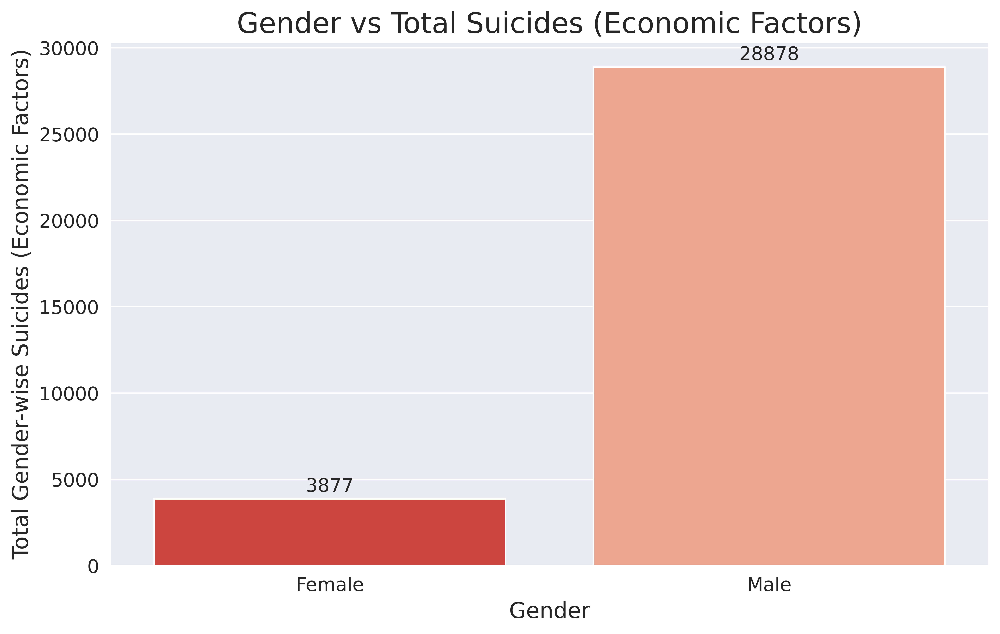

In [42]:
temp = df_causes_bank[['Gender','Total']].groupby(['Gender']).sum()
plt.figure(figsize=(10,6), dpi=720)
plt.title('Gender vs Total Suicides (Economic Factors)',fontsize=18)
c1 = sns.barplot(x=temp.index,y=temp.Total,palette="Reds_r")
c1.bar_label(c1.containers[0], padding=2, size = 12)
plt.xlabel('Gender', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Gender-wise Suicides (Economic Factors)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- Males tend to suicide lot more when compared to Females due to economic factors.

**Age-group wise Suicide rates on the basis of Economic Factors:**

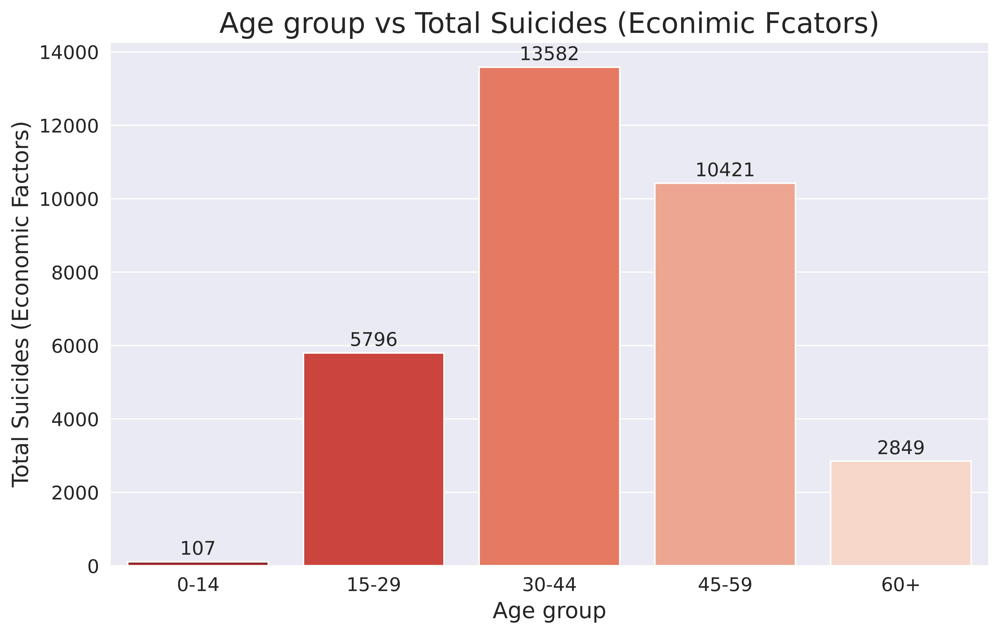

In [43]:
temp = df_causes_bank[['Age_group','Total']].groupby(['Age_group']).sum()
plt.figure(figsize=(10,6), dpi=720)
c1= sns.barplot(x=temp.index,y=temp.Total,palette="Reds_r")
c1.bar_label(c1.containers[0], padding=2, size=12)
plt.title('Age group vs Total Suicides (Econimic Fcators)',fontsize=18)
plt.xlabel('Age group', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Suicides (Economic Factors)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- People in the age group of 30-44 tend to suicide more only followed by people belonging to age group 45-59.

**State wise Suicide rates on the basis of Economic Factors:**

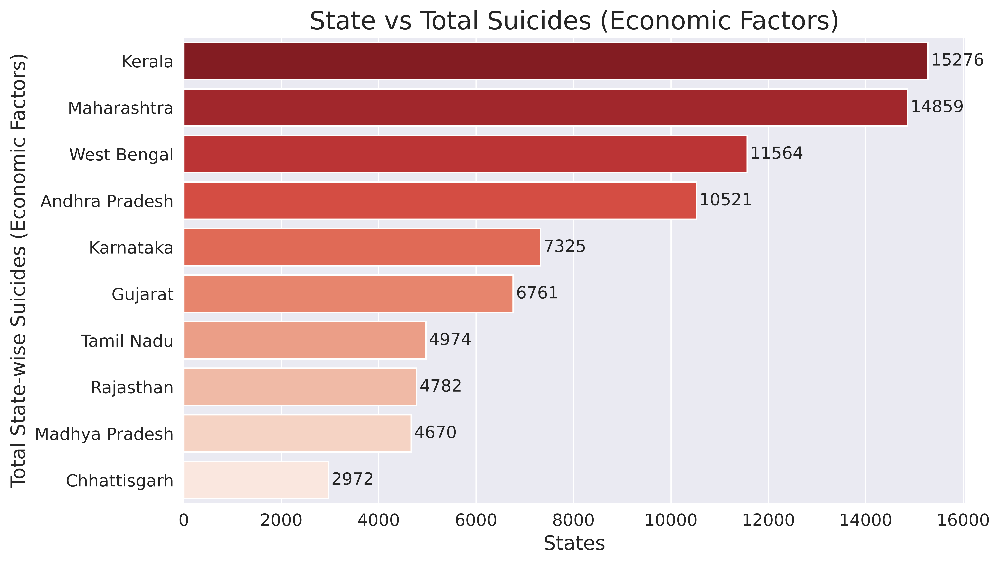

In [44]:
temp = df_causes_mi[['State','Total']].groupby(['State']).sum().sort_values('Total',ascending=False).head(10)
plt.figure(figsize=(10,6), dpi=720)
plt.title('State vs Total Suicides (Economic Factors)',fontsize=18)
c1 = sns.barplot(y=temp.index,x=temp.Total,palette="Reds_r")
c1.bar_label(c1.containers[0], padding=2, size = 12)
plt.xlabel('States', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total State-wise Suicides (Economic Factors)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- Suicides due to economic factors are high in Kerala followed by Maharashtra and West Bengal.

### Suicides on the basis of Gender, State, Year and Cause:

In [45]:
st_yr_cause_df = (df_causes.groupby(['State', 'Gender', 'Year', 'Type'])
                 .agg(value=pd.NamedAgg(column='Total', aggfunc='sum'))['value']
                  .unstack(fill_value=0).rename_axis(None, axis=1).unstack())
st_yr_cause_df['Total'] = st_yr_cause_df.sum(axis=1, numeric_only=True)
st_yr_cause_df.style.background_gradient(cmap='Reds')

## Education Status of People who have committed suicide:

In [46]:
filter_educational_status = pd.DataFrame(df[df["Type_code"]=="Education_Status"].groupby(["Type","Gender"])["Total"].sum()).reset_index()
g = sns.catplot(x="Type", y="Total",hue="Gender", kind="bar",palette="Reds_r",data=filter_educational_status,
                height=8, aspect=9/8)
g.set_xticklabels(fontsize=12, rotation=90)
plt.xlabel('Education Status', fontsize=14)
plt.ylabel('Total Education Status-wise Suicides', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- People with Low or No education tend to commit more suicide.
- People with Graduate and Diploma degrees.

### Suicides of People with No Education

In [47]:
df_edu = df[df.Type_code == 'Education_Status']
df_noedu = df_edu[df_edu.Type == 'No Education']
df_noedu.head()

,State,Year,Type_code,Type,Gender,Age_group,Total
261,A & N Islands,2001,Education_Status,No Education,Female,0-100+,4
272,A & N Islands,2001,Education_Status,No Education,Male,0-100+,7
824,A & N Islands,2002,Education_Status,No Education,Female,0-100+,0
834,A & N Islands,2002,Education_Status,No Education,Male,0-100+,0
1380,A & N Islands,2003,Education_Status,No Education,Female,0-100+,1


**Year wise suicide rates of people with No education:**

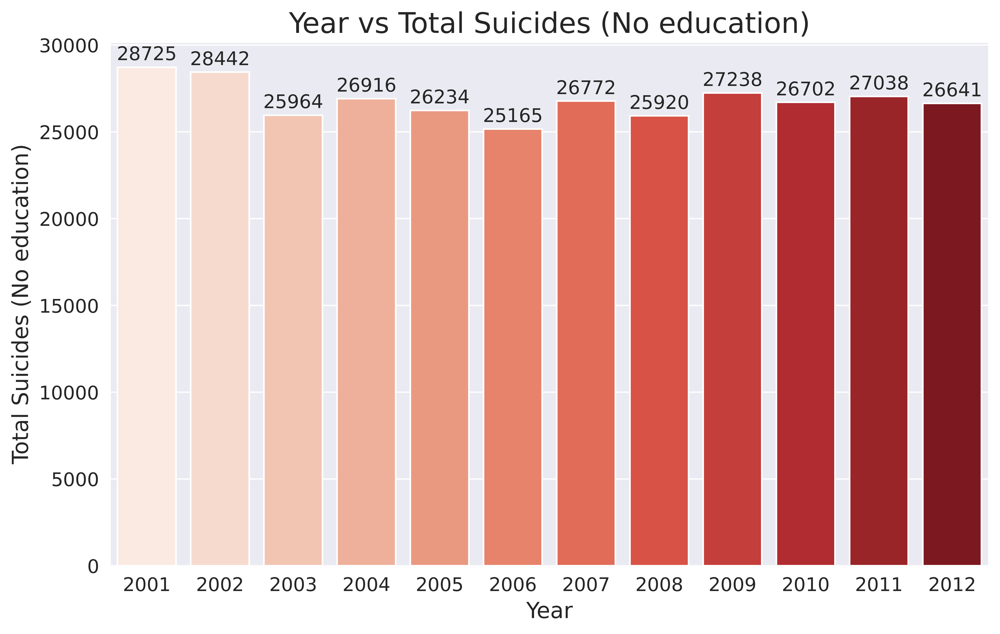

In [48]:
temp = df_noedu[['Year', 'Total']].groupby(['Year']).sum()
plt.figure(figsize=(10,6), dpi=720)
c1 = sns.barplot(x=temp.index,y=temp.Total,palette="Reds")
c1.bar_label(c1.containers[0], padding=2, size=12)
plt.title('Year vs Total Suicides (No education)',fontsize=18)
plt.xlabel('Year', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Suicides (No education)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Top 10 States with suicide rates where people aren't educated:**

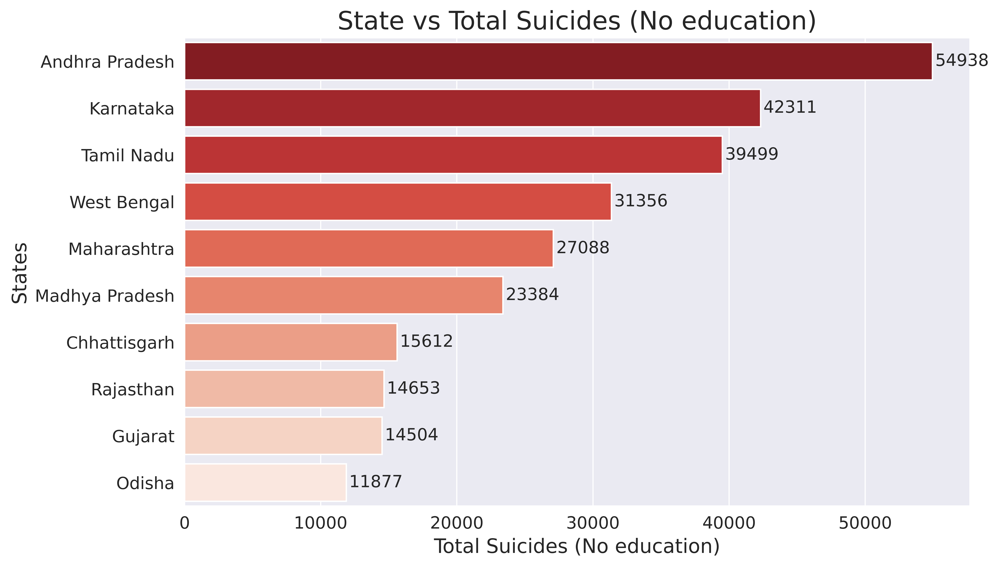

In [49]:
plt.figure(figsize=(10,6), dpi=720)
temp = df_noedu[['State', 'Total']].groupby(['State']).sum().sort_values('Total', ascending=False).head(10)
c1 = sns.barplot(y=temp.index,x=temp.Total,palette="Reds_r")
c1.bar_label(c1.containers[0], padding=2, size=12)
plt.title('State vs Total Suicides (No education)', fontsize=18)
plt.xlabel('Total Suicides (No education)', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('States', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- Andhra Pradesh, Karnataka and Tamil Nadu are the top 3 states with people having no education have high rates of suicides.

### Suicides of People with Primary Education

In [50]:
df_primary = df_edu[df_edu.Type == 'Primary']
df_primary.head()

,State,Year,Type_code,Type,Gender,Age_group,Total
266,A & N Islands,2001,Education_Status,Primary,Female,0-100+,7
275,A & N Islands,2001,Education_Status,Primary,Male,0-100+,20
826,A & N Islands,2002,Education_Status,Primary,Female,0-100+,0
830,A & N Islands,2002,Education_Status,Primary,Male,0-100+,15
1385,A & N Islands,2003,Education_Status,Primary,Female,0-100+,1


**Year wise suicide rates of people with primary education:**

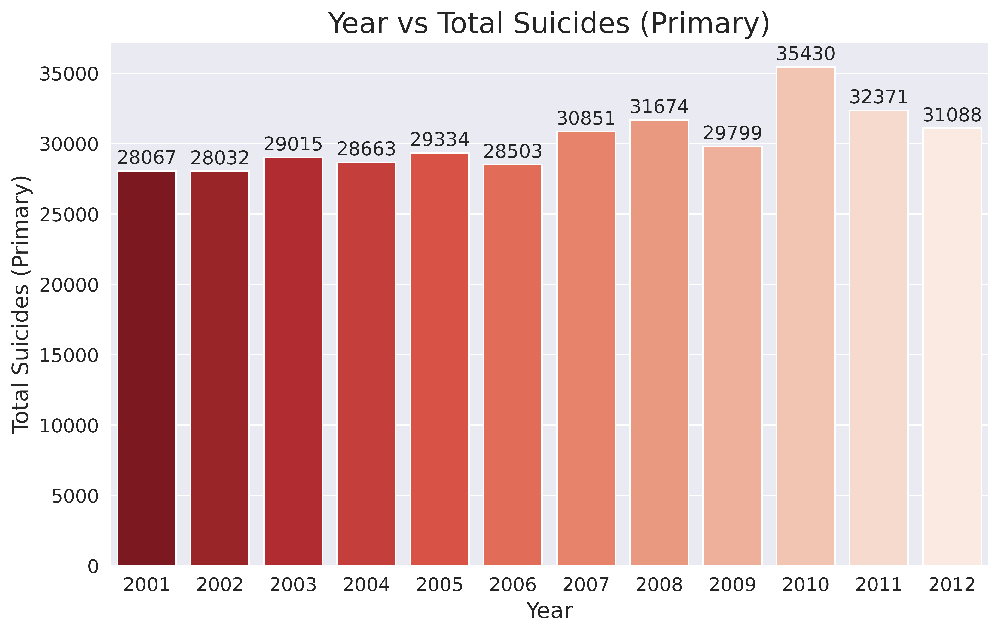

In [51]:
temp = df_primary[['Year','Total']].groupby(['Year']).sum()
plt.figure(figsize=(10,6), dpi=720)
c1=sns.barplot(x=temp.index,y=temp.Total,palette="Reds_r")
c1.bar_label(c1.containers[0], padding=2, size=12)
plt.title('Year vs Total Suicides (Primary)', fontsize=18)
plt.xlabel('Year', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Suicides (Primary)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Top 10 States with High Suicide rates among the primarily educated:**

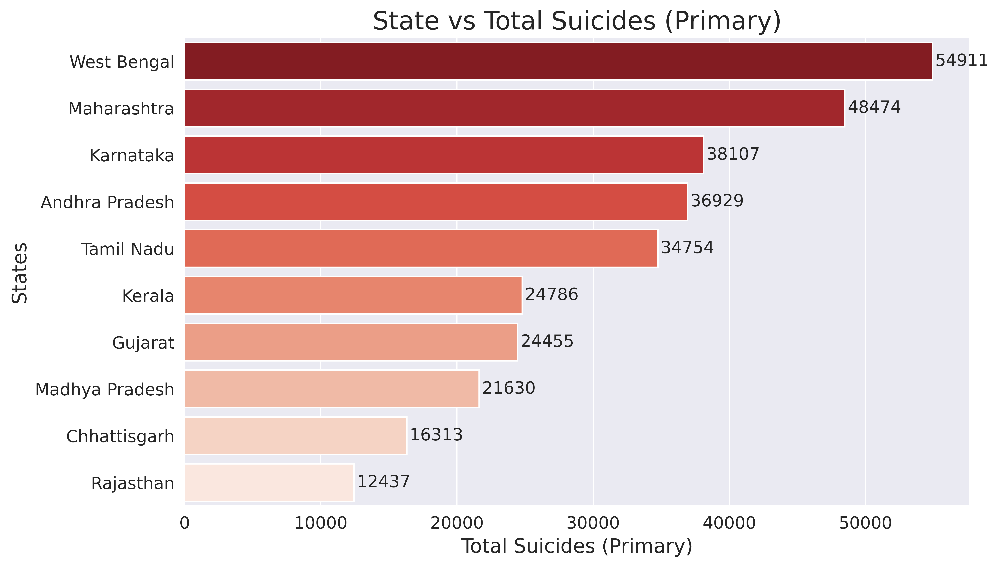

In [52]:
plt.figure(figsize=(10,6), dpi=720)
temp = df_primary[['State','Total']].groupby(['State']).sum().sort_values('Total',ascending=False).head(10)
c1 = sns.barplot(y=temp.index,x=temp.Total,palette="Reds_r")
c1.bar_label(c1.containers[0], padding=2, size=12)
plt.title('State vs Total Suicides (Primary)', fontsize=18)
plt.xlabel('Total Suicides (Primary)', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('States', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- West Bengal, Maharashtra, Karnataka are the top 3 states with people having primary education have high rates of suicides.

### Suicides on the basis of State, Gender and Age_group:

In [53]:
st_yr_age = (df_causes.groupby(["State","Gender", 'Age_group'])
        .agg(value=pd.NamedAgg(column="Total",aggfunc="sum"))['value']
        .unstack( fill_value=0)
        .rename_axis(None, axis=1)
        .unstack(level=1).unstack().unstack())
st_yr_age.style.background_gradient(cmap='Reds', axis=1)

### Profession of the People who committed suicide:

In [54]:
filter_profession_status = pd.DataFrame(df[df.Type_code == "Professional_Profile"]).groupby(['Type', 'Gender'])['Total'].sum().reset_index()
g = sns.catplot(x='Type', y='Total', hue='Gender', kind='bar', 
                palette='Reds_r', data=filter_profession_status, height=8, aspect=9/8)
g.set_xticklabels(rotation=90, fontsize=12)
plt.xlabel("Profession Type", fontsize=14)
plt.ylabel("Total Profession-wise Suicides", fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- Farmers and Housewives tend to commit more suicides.

### Housewives

In [55]:
df_social = df[df.Type_code == 'Professional_Profile']
df_housewives = df_social[df_social.Type == 'House Wife']
df_housewives.head()

,State,Year,Type_code,Type,Gender,Age_group,Total
440,A & N Islands,2001,Professional_Profile,House Wife,Female,0-14,0
457,A & N Islands,2001,Professional_Profile,House Wife,Male,0-14,0
461,A & N Islands,2001,Professional_Profile,House Wife,Female,15-29,21
481,A & N Islands,2001,Professional_Profile,House Wife,Male,15-29,0
484,A & N Islands,2001,Professional_Profile,House Wife,Female,30-44,9


**Age-group wise suicide rates of Housewives:**

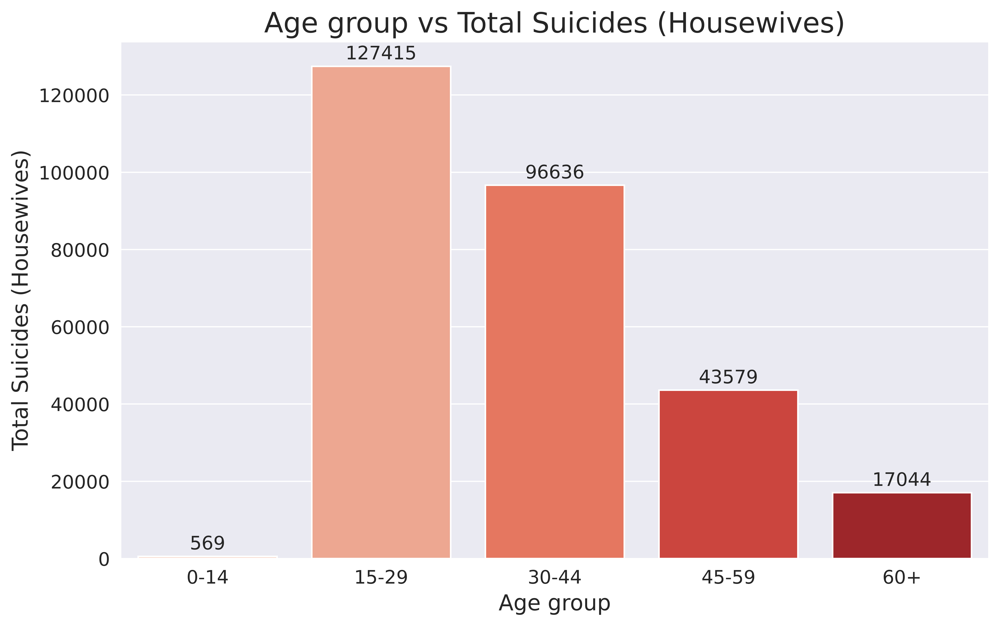

In [56]:
temp = df_housewives[['Age_group','Total']].groupby(['Age_group']).sum()
plt.figure(figsize=(10,6), dpi=720)
c1 = sns.barplot(x=temp.index,y=temp.Total,palette='Reds')
c1.bar_label(c1.containers[0], padding=2, fontsize=12)
plt.title('Age group vs Total Suicides (Housewives)',fontsize=18)
plt.xlabel('Age group', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Suicides (Housewives)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- There is a linear declination of Suicides as Females grow older.

**State wise suicide rates of Housewives:**

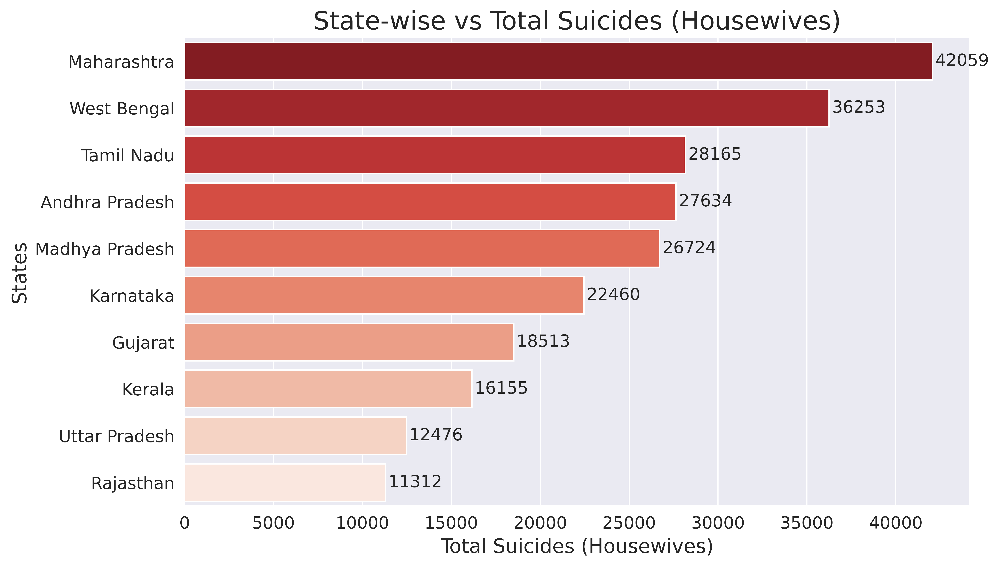

In [57]:
temp = df_housewives[['State','Total']].groupby(['State']).sum().sort_values('Total',ascending=False).head(10)
plt.figure(figsize=(10,6), dpi=720)
c1 = sns.barplot(y=temp.index,x=temp.Total,palette='Reds_r')
c1.bar_label(c1.containers[0], padding=2, fontsize=12)
plt.title('State-wise vs Total Suicides (Housewives)',fontsize=18)
plt.xlabel('Total Suicides (Housewives)', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('States', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- Maharashtra is a topper state for suicides due to Family Problems and suicides of Housewives.

### Farming / Agriculture

In [58]:
df_farmers = df_social[df_social.Type=='Farming/Agriculture Activity']
df_farmers.head()

,State,Year,Type_code,Type,Gender,Age_group,Total
445,A & N Islands,2001,Professional_Profile,Farming/Agriculture Activity,Female,0-14,0
449,A & N Islands,2001,Professional_Profile,Farming/Agriculture Activity,Male,0-14,0
470,A & N Islands,2001,Professional_Profile,Farming/Agriculture Activity,Female,15-29,0
471,A & N Islands,2001,Professional_Profile,Farming/Agriculture Activity,Male,15-29,0
490,A & N Islands,2001,Professional_Profile,Farming/Agriculture Activity,Female,30-44,0


**Gender-wise Suicides of people associated with Farming/Agriculture:**

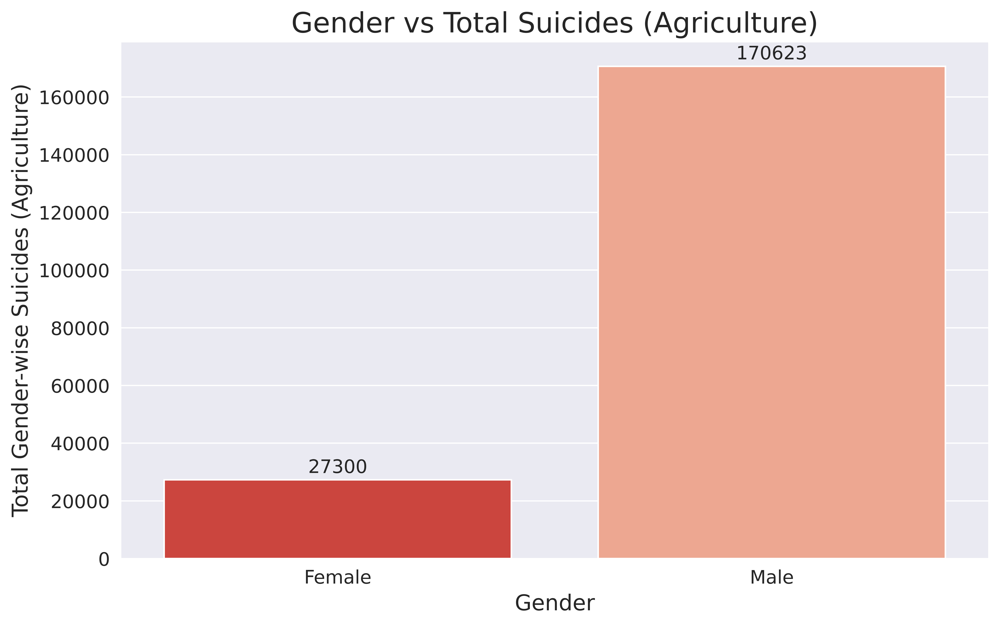

In [59]:
temp = df_farmers[['Gender','Total']].groupby(['Gender']).sum()
plt.figure(figsize=(10,6), dpi=720)
plt.title('Gender vs Total Suicides (Agriculture)',fontsize=18)
c1 = sns.barplot(x=temp.index,y=temp.Total,palette="Reds_r")
c1.bar_label(c1.containers[0], padding=2, size = 12)
plt.xlabel('Gender', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Gender-wise Suicides (Agriculture)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Age-group wise suicide rates of people associated with Farming/Agriculture:**

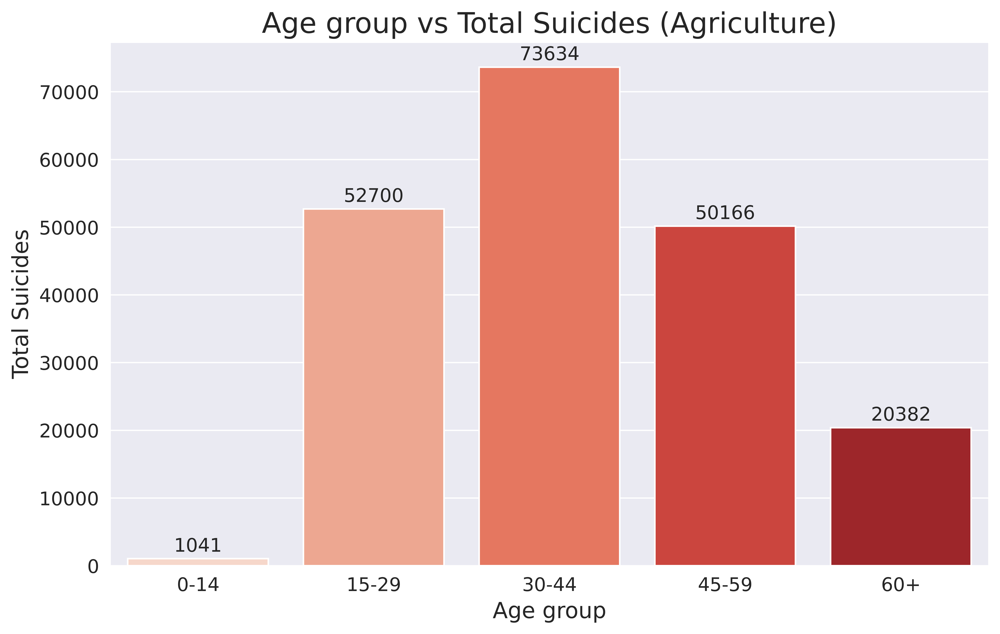

In [60]:
temp = df_farmers[['Age_group','Total']].groupby(['Age_group']).sum()
plt.figure(figsize=(10,6), dpi=720)
c1 = sns.barplot(x=temp.index,y=temp.Total,palette='Reds')
c1.bar_label(c1.containers[0], padding=2, fontsize=12)
plt.title('Age group vs Total Suicides (Agriculture)', fontsize=18)
plt.xlabel('Age group', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Suicides', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- People in the age group of 30-44 commit more suicide when compared to people associated with farming in the range 15-29 or 45-59.

**State wise suicide rates of people associated with Farming/Agriculture:**

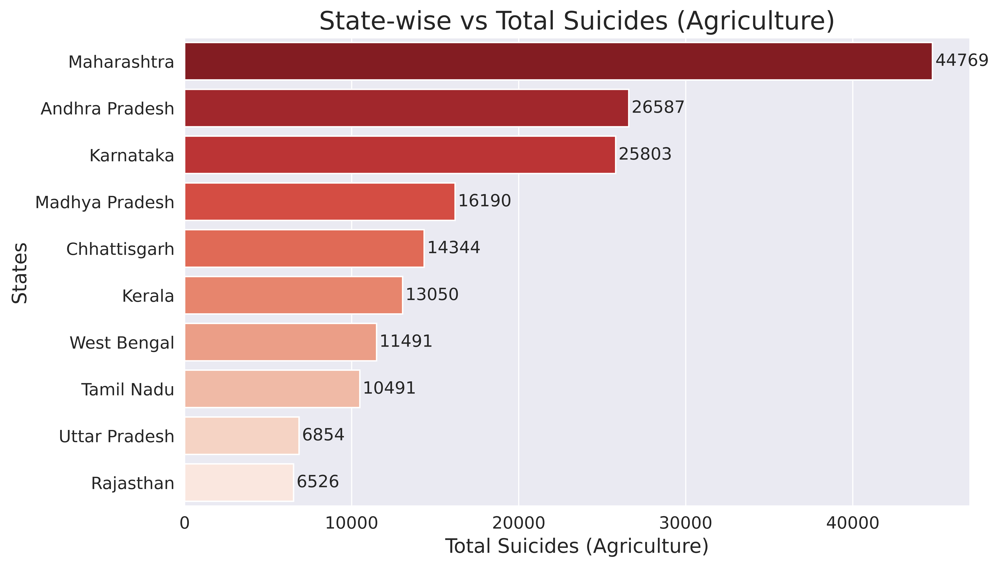

In [61]:
temp = df_farmers[['State','Total']].groupby(['State']).sum().sort_values('Total',ascending=False).head(10)
plt.figure(figsize=(10,6), dpi=720)
c1 = sns.barplot(y=temp.index,x=temp.Total,palette='Reds_r')
c1.bar_label(c1.containers[0], padding=2, fontsize=12)
plt.title('State-wise vs Total Suicides (Agriculture)',fontsize=18)
plt.xlabel('Total Suicides (Agriculture)', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('States', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- People from the states Maharashtra, Andhra Pradesh, Karnataka related with Farming / Agriculture activities and tends to commit more suicides.

### Relationship Statuses

In [62]:
df_socialStatus = df[df['Type_code'] == 'Social_Status']
df_socialStatus.head()

,State,Year,Type_code,Type,Gender,Age_group,Total
552,A & N Islands,2001,Social_Status,Married,Female,0-100+,38
553,A & N Islands,2001,Social_Status,Seperated,Female,0-100+,0
554,A & N Islands,2001,Social_Status,Widowed/Widower,Female,0-100+,0
555,A & N Islands,2001,Social_Status,Divorcee,Female,0-100+,0
556,A & N Islands,2001,Social_Status,Never Married,Female,0-100+,12


**Relationship status wise Suicide rates:**

                   Total
Type                    
Married          1021774
Never Married     318301
Widowed/Widower    62113
Seperated          38471
Divorcee           15272


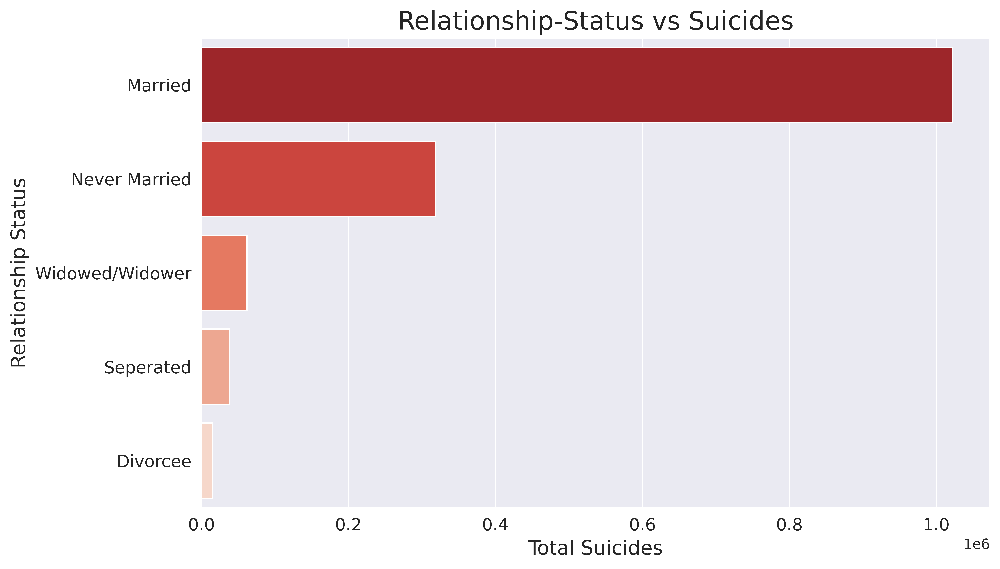

In [63]:
temp = df_socialStatus[['Type','Total']].groupby(['Type']).sum().sort_values('Total',ascending=False)
print(temp)
plt.figure(figsize=(10,6), dpi=720)
c1 = sns.barplot(y=temp.index,x=temp.Total,palette='Reds_r')
# c1.bar_label(c1.containers[0], padding=2, fontsize=12)
plt.title('Relationship-Status vs Suicides',fontsize=18)
plt.xlabel('Total Suicides', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Relationship Status', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- The chances of Suicides are much more in Married people than Never Married people.

**Gender wise Suicide rates of People based on their Relationship Status:**

<Figure size 4608x3456 with 0 Axes>

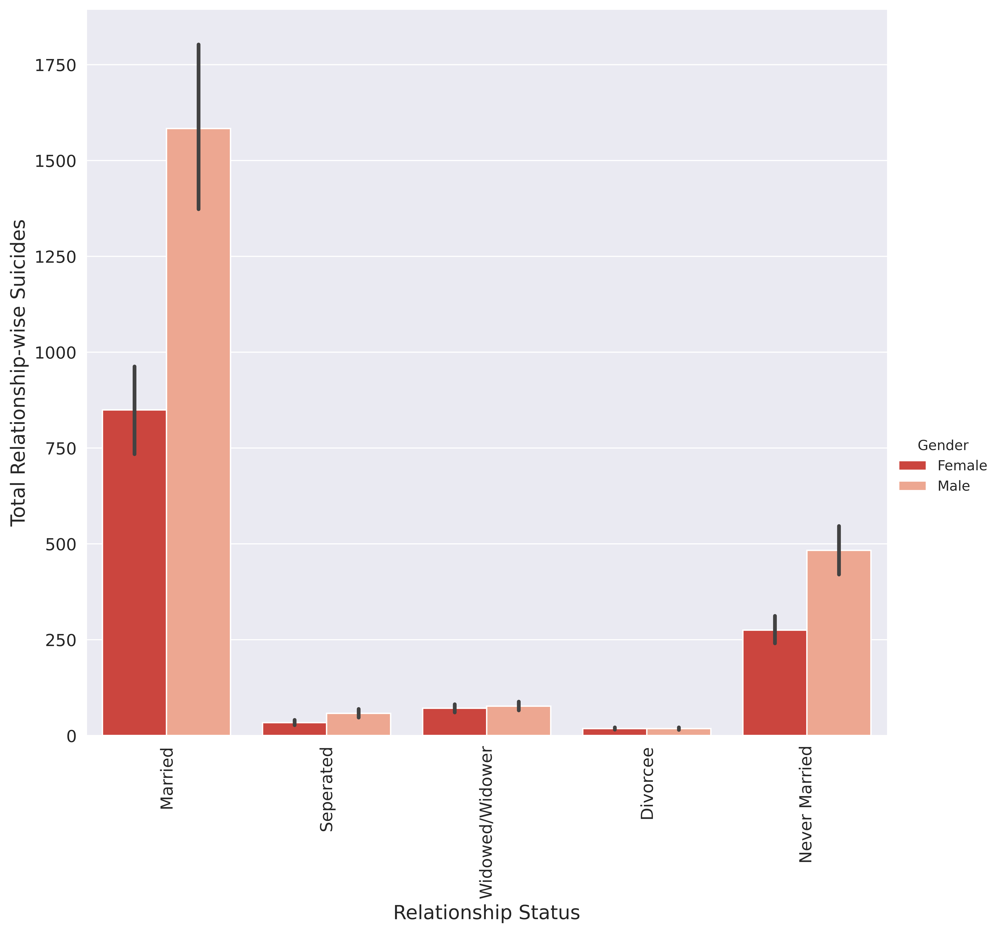

In [64]:
plt.figure(dpi=720)
df_socialStatus.reset_index()
g = sns.catplot(x='Type', y='Total', hue='Gender', kind='bar', 
                palette='Reds_r', data=df_socialStatus, height=8, aspect=9/8)
g.set_xticklabels(rotation=90, fontsize=12)
plt.xlabel("Relationship Status", fontsize=14)
plt.ylabel("Total Relationship-wise Suicides", fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- Males tends to commit more suicides in any kind of relationship status.

**State-wise Suicide rates of people who were married:**

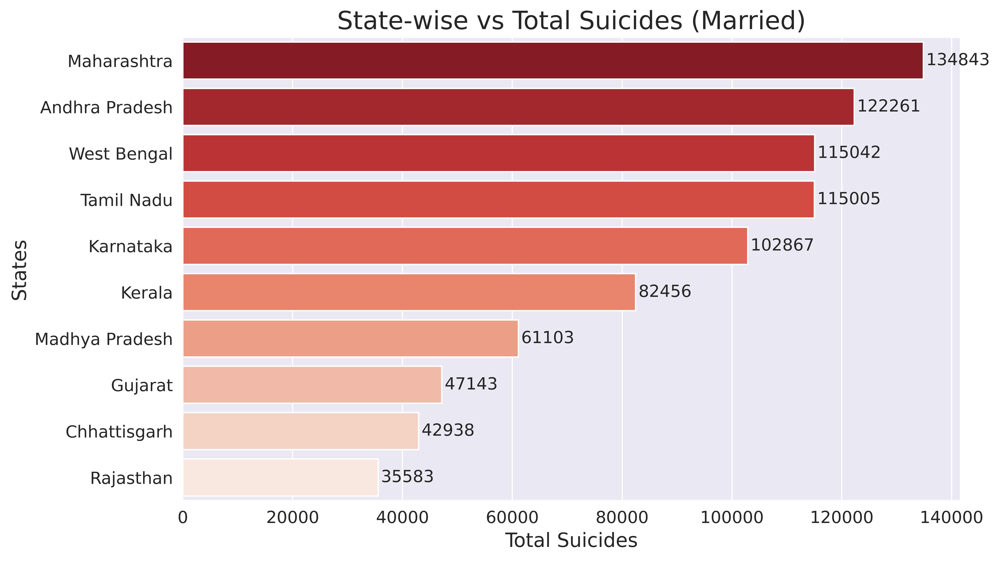

In [65]:
temp = df_socialStatus[df_socialStatus['Type'] == 'Married']
temp = temp[['State','Total']].groupby(['State']).sum().sort_values('Total',ascending=False)
temp = temp[(temp.index != 'Total (All India)') & (temp.index != 'Total (States)') & (temp.index != 'Total (Uts)')]
temp = temp.head(10)
plt.figure(figsize=(10,6), dpi=720)
c1 = sns.barplot(y=temp.index,x=temp.Total,palette='Reds_r')
c1.bar_label(c1.containers[0], padding=2, fontsize=12)
plt.title('State-wise vs Total Suicides (Married)',fontsize=18)
plt.xlabel('Total Suicides', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('States', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

### Means adopted

In [66]:
df_means = df[df.Type_code == 'Means_adopted']
df_means.head()

,State,Year,Type_code,Type,Gender,Age_group,Total
276,A & N Islands,2001,Means_adopted,By Consuming Insecticides,Female,0-14,0
277,A & N Islands,2001,Means_adopted,By Hanging,Female,0-14,2
278,A & N Islands,2001,Means_adopted,By Jumping from (Other sites),Female,0-14,0
279,A & N Islands,2001,Means_adopted,By touching electric wires,Female,0-14,0
280,A & N Islands,2001,Means_adopted,By Machine,Female,0-14,0


### Suicide count based on the Means Adopted:

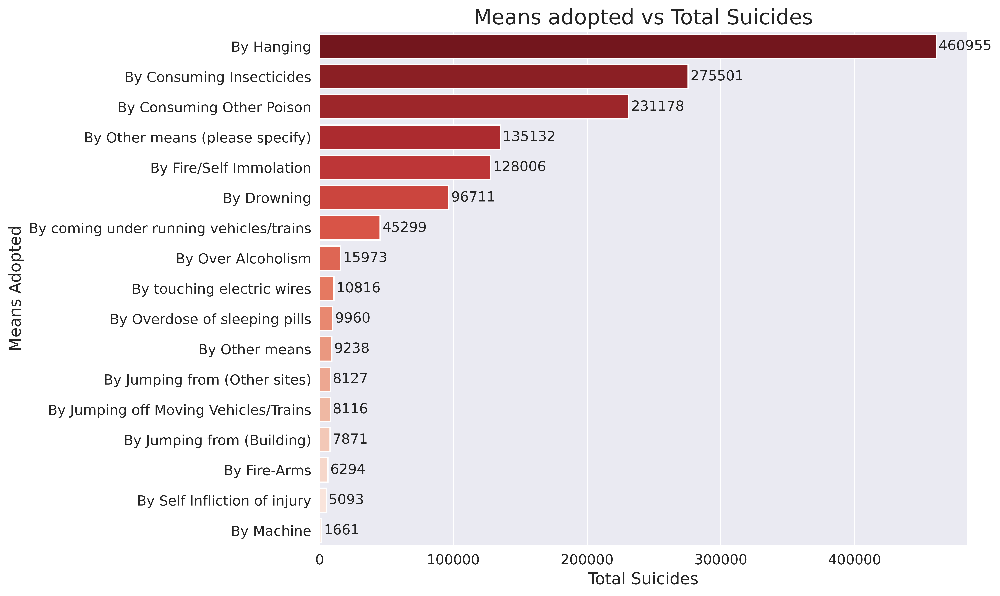

In [67]:
plt.figure(figsize=(10,8))
temp = df_means[['Type','Total']].groupby(['Type']).sum().sort_values('Total',ascending=False)
c1=sns.barplot(y=temp.index,x=temp.Total,palette="Reds_r")
c1.bar_label(c1.containers[0], padding=2, fontsize=12)
plt.title('Means adopted vs Total Suicides',fontsize=18)
plt.ylabel('Means Adopted', fontsize=14)
plt.yticks(fontsize=12)
plt.xlabel('Total Suicides', fontsize=14)
plt.xticks(fontsize=12)
plt.show()

**Inference**
- Top methods by which people suicide include by Hanging, by consuming insecticides or by consuming other poison.

### Hanging

In [68]:
df_means_hang = df_means[df_means.Type=='By Hanging']
df_means_hang.head()

,State,Year,Type_code,Type,Gender,Age_group,Total
277,A & N Islands,2001,Means_adopted,By Hanging,Female,0-14,2
307,A & N Islands,2001,Means_adopted,By Hanging,Male,0-14,2
316,A & N Islands,2001,Means_adopted,By Hanging,Female,15-29,20
337,A & N Islands,2001,Means_adopted,By Hanging,Male,15-29,20
352,A & N Islands,2001,Means_adopted,By Hanging,Female,30-44,7


**Gender-wise suicide by hanging:**

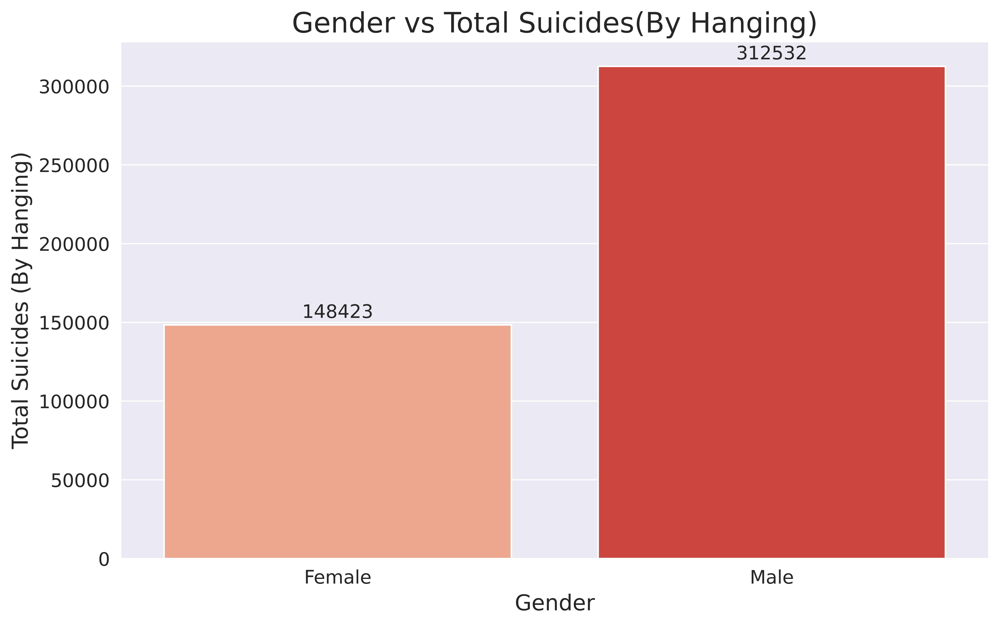

In [69]:
temp = df_means_hang[['Gender','Total']].groupby(['Gender']).sum()
plt.figure(figsize=(10,6), dpi=720)
c1=sns.barplot(x=temp.index,y=temp.Total,palette="Reds")
c1.bar_label(c1.containers[0], padding=2, fontsize=12)
plt.title('Gender vs Total Suicides(By Hanging)', fontsize=18)
plt.xlabel('Gender', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Suicides (By Hanging)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Age-group wise suicide rates by Hanging:**

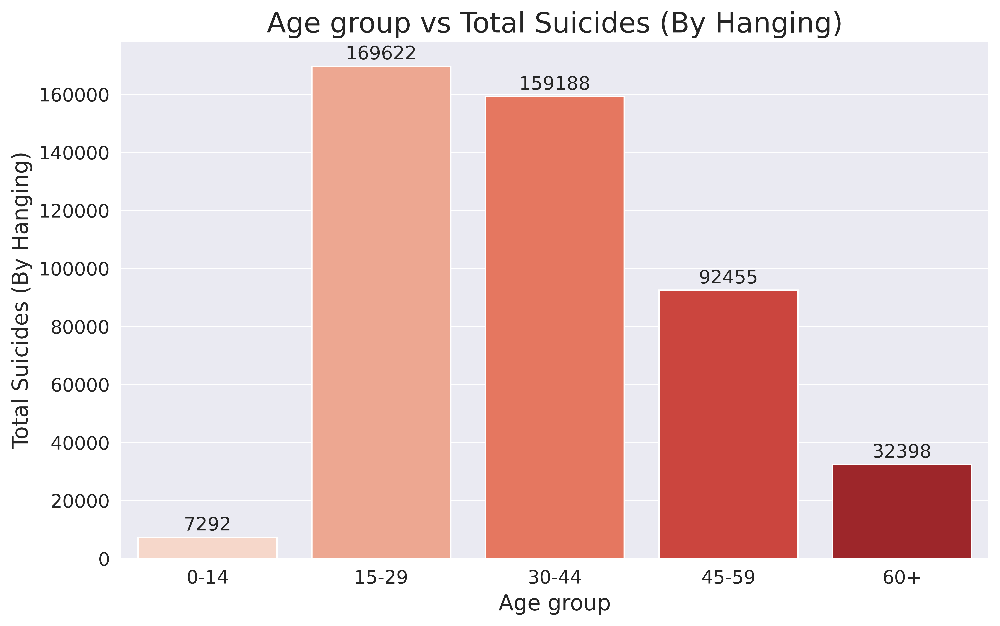

In [70]:
temp = df_means_hang[['Age_group','Total']].groupby(['Age_group']).sum()
plt.figure(figsize=(10,6), dpi=720)
c1 = sns.barplot(x=temp.index,y=temp.Total,palette='Reds')
c1.bar_label(c1.containers[0], padding=2, fontsize=12)
plt.title('Age group vs Total Suicides (By Hanging)',fontsize=18)
plt.xlabel('Age group', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Suicides (By Hanging)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- There is linear declination of suicides by Hanging as you grow older.

**State wise suicide rates by Hanging:**

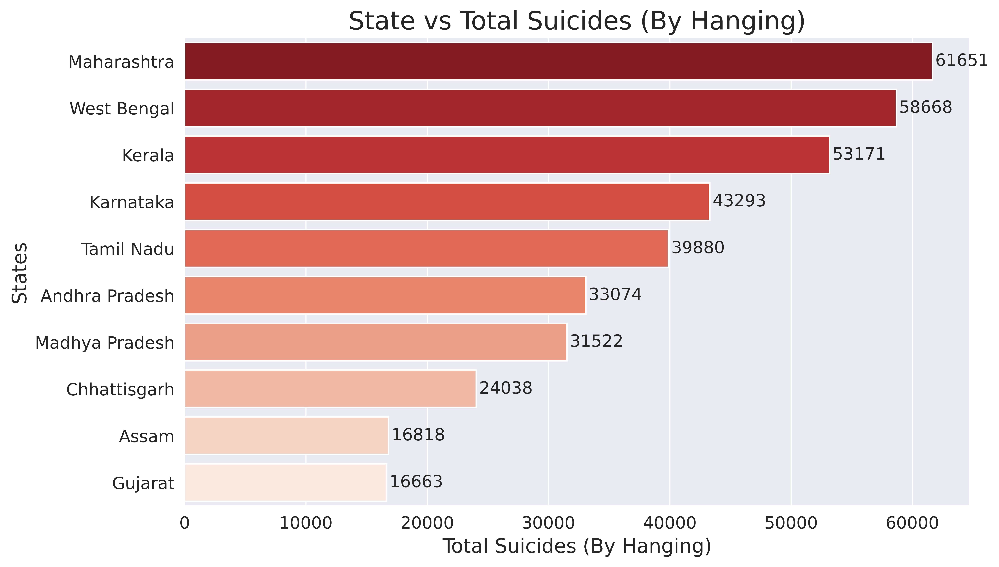

In [71]:
temp = df_means_hang[['State','Total']].groupby(['State']).sum().sort_values('Total',ascending=False).head(10)
plt.figure(figsize=(10,6), dpi=720)
c1 = sns.barplot(y=temp.index,x=temp.Total,palette='Reds_r')
c1.bar_label(c1.containers[0], padding=2, fontsize=12)
plt.title('State vs Total Suicides (By Hanging)', fontsize=18)
plt.xlabel('Total Suicides (By Hanging)', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('States', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

### By Consuming Insecticides

In [72]:
df_means_insec = df_means[df_means.Type=='By Consuming Insecticides']
df_means_insec.head()

,State,Year,Type_code,Type,Gender,Age_group,Total
276,A & N Islands,2001,Means_adopted,By Consuming Insecticides,Female,0-14,0
296,A & N Islands,2001,Means_adopted,By Consuming Insecticides,Male,0-14,0
318,A & N Islands,2001,Means_adopted,By Consuming Insecticides,Female,15-29,0
338,A & N Islands,2001,Means_adopted,By Consuming Insecticides,Male,15-29,0
344,A & N Islands,2001,Means_adopted,By Consuming Insecticides,Female,30-44,0


**Gender-wise suicide by consuming insecticides:**

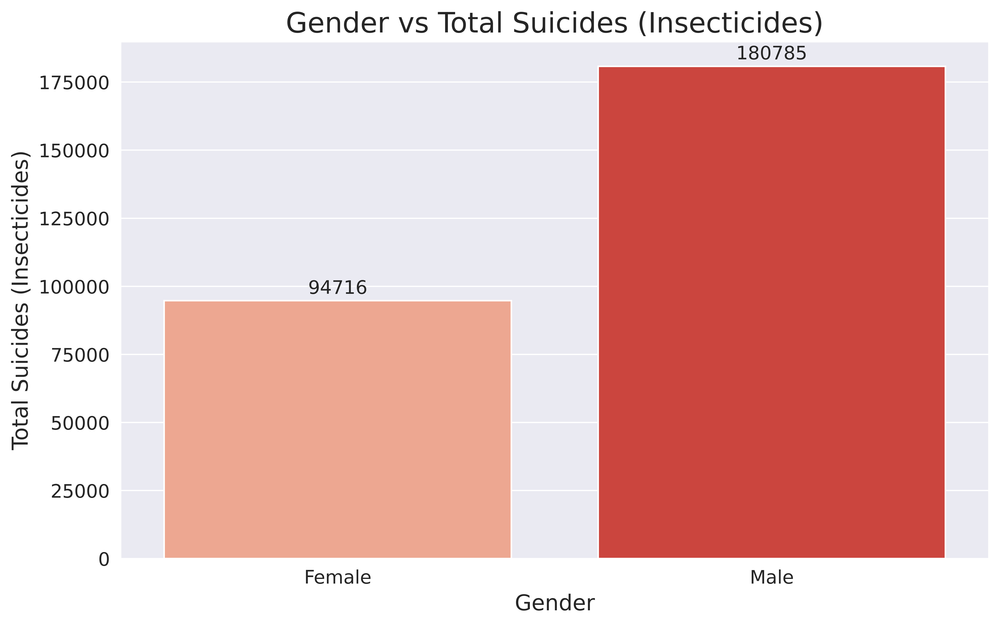

In [73]:
temp = df_means_insec[['Gender','Total']].groupby(['Gender']).sum()
plt.figure(figsize=(10,6), dpi=720)
c1 =sns.barplot(x=temp.index,y=temp.Total,palette="Reds")
c1.bar_label(c1.containers[0], padding=2, fontsize=12)
plt.title('Gender vs Total Suicides (Insecticides)', fontsize=18)
plt.xlabel('Gender', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Suicides (Insecticides)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Age-group wise suicide rates by consuming insecticides:**

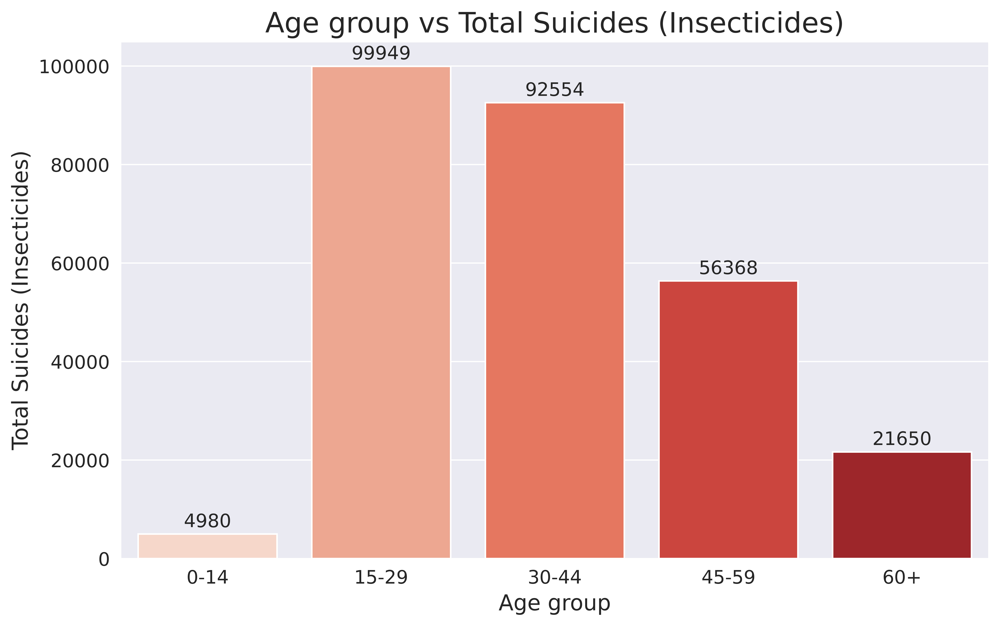

In [74]:
temp = df_means_insec[['Age_group','Total']].groupby(['Age_group']).sum()
plt.figure(figsize=(10,6), dpi=720)
c1 = sns.barplot(x=temp.index,y=temp.Total,palette='Reds')
c1.bar_label(c1.containers[0], padding=2, fontsize=12)
plt.title('Age group vs Total Suicides (Insecticides)',fontsize=18)
plt.xlabel('Age group', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('Total Suicides (Insecticides)', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- As people grow older there are much less chance of suicide by Insecticides.

**State wise suicide rates by consuming insecticides:**

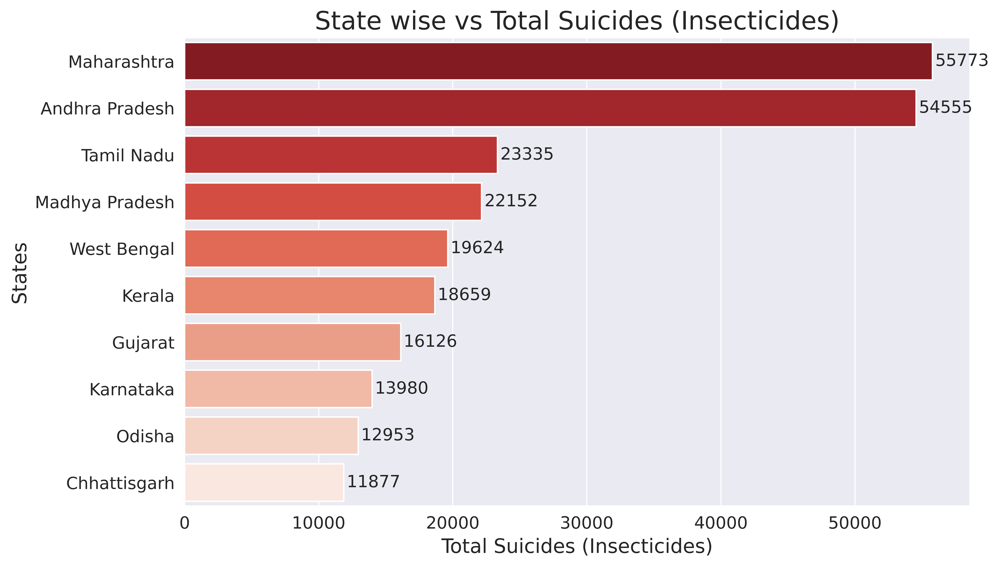

In [75]:
temp = df_means_insec[['State','Total']].groupby(['State']).sum().sort_values('Total',ascending=False).head(10)
plt.figure(figsize=(10,6), dpi=720)
c1 = sns.barplot(y=temp.index,x=temp.Total,palette='Reds_r')
c1.bar_label(c1.containers[0], padding=2, fontsize=12)
plt.title('State wise vs Total Suicides (Insecticides)', fontsize=18)
plt.xlabel('Total Suicides (Insecticides)', fontsize=14)
plt.xticks(fontsize=12)
plt.ylabel('States', fontsize=14)
plt.yticks(fontsize=12)
plt.show()

**Inference**
- Maharashtra have high suicide rates by Hanging and consumption of Insecticides.

## Thanks for reading the Notebook , Feel free to Upvote if you find it useful!